# Evaluation Project:Rainfall Prediction - Weather Forecasting

# Evaluation Project: subpart 1

# Rainfall Prediction - Weather Forecasting Classification Predictive Analysis, Model Development, Model Evaluation and Model Selection Project

# Problem Statement

# Rainfall Prediction - Weather Forecasting is a classification based problem statement to classify rainfall tomorrow in yes and no responses from several indicators. The Dataset contains about 10 years of daily weather observations of different locations in Australia.

# Importing Data From Github repository dsrscientist/dataset3/main/weatherAUS.csv

In [1]:
# Importing Required Libraries And Data

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
warnings.filterwarnings('ignore')
data=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv')
data1=data.copy()  # creating a copy of dataframe
data2=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv', parse_dates=['Date'], index_col=0)
data

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


# I have created 2 datsets, data1 for timeseries analysis qna and anomalies; data for predictive analysis.

In [3]:
data['RainTomorrow'].unique(), len(data['RainTomorrow'].unique())

(array(['No', 'Yes', nan], dtype=object), 3)

In [4]:
# Observation 1
shape_of_data=data.shape
print('Number Of Rows: ',shape_of_data[0], 'Number Of Columns: ', shape_of_data[1])

Number Of Rows:  8425 Number Of Columns:  23


In [5]:
data.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [6]:
# Checking column names to detect unnamed columns

In [7]:
print('Type of storage of data ', type(data), '\nType of data series ', type(data.columns))

Type of storage of data  <class 'pandas.core.frame.DataFrame'> 
Type of data series  <class 'pandas.core.indexes.base.Index'>


In [8]:
data.isna().any()

Date             False
Location         False
MinTemp           True
MaxTemp           True
Rainfall          True
Evaporation       True
Sunshine          True
WindGustDir       True
WindGustSpeed     True
WindDir9am        True
WindDir3pm        True
WindSpeed9am      True
WindSpeed3pm      True
Humidity9am       True
Humidity3pm       True
Pressure9am       True
Pressure3pm       True
Cloud9am          True
Cloud3pm          True
Temp9am           True
Temp3pm           True
RainToday         True
RainTomorrow      True
dtype: bool

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

In [10]:
data.isna().values.any()

True

In [11]:
data.isnull().values.sum()

19472

In [12]:
data=data.fillna(method='backfill')
data=data.fillna(method='ffill')
data2=data2.fillna(method='backfill')
data2=data2.fillna(method='ffill')
data.isna().any(), data2.isna().any()

(Date             False
 Location         False
 MinTemp          False
 MaxTemp          False
 Rainfall         False
 Evaporation      False
 Sunshine         False
 WindGustDir      False
 WindGustSpeed    False
 WindDir9am       False
 WindDir3pm       False
 WindSpeed9am     False
 WindSpeed3pm     False
 Humidity9am      False
 Humidity3pm      False
 Pressure9am      False
 Pressure3pm      False
 Cloud9am         False
 Cloud3pm         False
 Temp9am          False
 Temp3pm          False
 RainToday        False
 RainTomorrow     False
 dtype: bool,
 Location         False
 MinTemp          False
 MaxTemp          False
 Rainfall         False
 Evaporation      False
 Sunshine         False
 WindGustDir      False
 WindGustSpeed    False
 WindDir9am       False
 WindDir3pm       False
 WindSpeed9am     False
 WindSpeed3pm     False
 Humidity9am      False
 Humidity3pm      False
 Pressure9am      False
 Pressure3pm      False
 Cloud9am         False
 Cloud3pm         False
 T

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8425 non-null   float64
 3   MaxTemp        8425 non-null   float64
 4   Rainfall       8425 non-null   float64
 5   Evaporation    8425 non-null   float64
 6   Sunshine       8425 non-null   float64
 7   WindGustDir    8425 non-null   object 
 8   WindGustSpeed  8425 non-null   float64
 9   WindDir9am     8425 non-null   object 
 10  WindDir3pm     8425 non-null   object 
 11  WindSpeed9am   8425 non-null   float64
 12  WindSpeed3pm   8425 non-null   float64
 13  Humidity9am    8425 non-null   float64
 14  Humidity3pm    8425 non-null   float64
 15  Pressure9am    8425 non-null   float64
 16  Pressure3pm    8425 non-null   float64
 17  Cloud9am       8425 non-null   float64
 18  Cloud3pm

In [14]:
data.isnull().values.sum()

0

In [15]:
data.dtypes, len(data.dtypes)

(Date              object
 Location          object
 MinTemp          float64
 MaxTemp          float64
 Rainfall         float64
 Evaporation      float64
 Sunshine         float64
 WindGustDir       object
 WindGustSpeed    float64
 WindDir9am        object
 WindDir3pm        object
 WindSpeed9am     float64
 WindSpeed3pm     float64
 Humidity9am      float64
 Humidity3pm      float64
 Pressure9am      float64
 Pressure3pm      float64
 Cloud9am         float64
 Cloud3pm         float64
 Temp9am          float64
 Temp3pm          float64
 RainToday         object
 RainTomorrow      object
 dtype: object,
 23)

# Tabulated Conclusion Of Data Cleaning

In [16]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8425 non-null   float64
 3   MaxTemp        8425 non-null   float64
 4   Rainfall       8425 non-null   float64
 5   Evaporation    8425 non-null   float64
 6   Sunshine       8425 non-null   float64
 7   WindGustDir    8425 non-null   object 
 8   WindGustSpeed  8425 non-null   float64
 9   WindDir9am     8425 non-null   object 
 10  WindDir3pm     8425 non-null   object 
 11  WindSpeed9am   8425 non-null   float64
 12  WindSpeed3pm   8425 non-null   float64
 13  Humidity9am    8425 non-null   float64
 14  Humidity3pm    8425 non-null   float64
 15  Pressure9am    8425 non-null   float64
 16  Pressure3pm    8425 non-null   float64
 17  Cloud9am       8425 non-null   float64
 18  Cloud3pm

In [17]:
data1=data.copy() #updating changes in data1

# # Verbal Translation Of Conclusion Of Above Data Cleaning Process

# Conclusion:
1. The dataset had 19472 missing values, that I have filled with default values and backfill methods, where applicable. The dataset does not have missing values now.
2. The whole dataset is of 8425 rows *23 columns shape, hence, chances of overerfitting, that is, model getting trained more than essential are high so we will go through the data thoroughly and try to draw anomalies and code some derived features, that can be of help in making predictions.
3. There are 16 continuous columns and 7 categorical columns, hence, encoding is required.

# EDA

# Count Plots Of Categorical Values


In [18]:
import plotly.express as px
for x in data1.select_dtypes(object).columns:
    if x =='Date':
        fig=px.bar(data, x, title=x)
        fig.show()
    else:
        fig=px.pie(data1,x,title=x)
        fig.show()

# Tabulated Analysis Of Above Countplots


In [19]:
object_description=data1.select_dtypes(object).describe()
object_description=object_description.rename(index={'count':'count of values', 'unique':'unique values', 'top':'most frequent value', 'freq':'frequency of most frequent value'})
dict1=object_description.iloc[0,:]-object_description.iloc[3,:]
object_description1=pd.concat([object_description, pd.DataFrame(dict1).T])
object_description1=object_description1.rename(index={0:'count of remaining values'})
object_description1

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count of values,8425,8425,8425,8425,8425,8425,8425
unique values,3004,12,16,16,16,2,2
most frequent value,2011-06-22,Melbourne,NW,N,SE,No,No
frequency of most frequent value,5,1622,1227,962,894,6263,6259
count of remaining values,8420,6803,7198,7463,7531,2162,2166


# Verbal Translation Of Above Table

# Anomalies Detected
## 1. There are 7 categorical features: Date, Location, WindGustDir, WindDir9am, WindDir3pm, RainToday, RainTomorrow.

## 2. There are 3004 unique values in: date and most frequent value has appeared just 5 times. 

## 3. There are 2 unique values in: Rain Today and Rain Tomorrow.

## 4. There are 12 unique values in location.

## 5. All the records are from different locations in Australia.

## 6. Months between 2011 and 2012 appeared maximum number of times.

## 7. Melbourne weather station appeared maximum times and Ulluru minimum times.

## 8. The direction of the strongest wind gust in the 24 hours to midnight has been North West most of the times.

## 9. Direction of the wind at 9am has most been North.

## 10. Direction of the wind at 3pm has mostly been South East.

## 11. RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0 is mostly 0, hence precipitation in 24 hours to 9 am has not exceeded 1mm for 74.3% as per 74.3% weather stations.

## 12. Rain is majorly not expected tomorrow.

## 13. There are 16 unique values in wind direction.

# QnA Answered:

## 1. Most windy region at 9 am: North

## 2. Least windy region at 9 am: East South East

## 3. For what percentage of weather stations has precipitation (mm) in the 24 hours to 9am exceeded 1mm: 25.7%

In [20]:
import cufflinks as cf
cf.set_config_file(offline=True)
#data2=data.copy()
#data2=data2.set_index('commissioning_year')
data2=data2.sort_index()
data2['Rainfall'].iplot(title='Time Series View Of Daily Rainfall')

# Anomalies Detected

## 1. The amount of rainfall recorded daily for 10 years ranges from 0 mm to 400 mm.

## 2. The year 2009 in the month of November experienced maximum rainfall.

## 3. In year 2013, curve has become flat for a short time but then has again increased to over 100 mm.

## 4. There are many fluctuations in rainfall amount with second highest amount of rainfall, 240 mm recorded in April 2015

# Dataset Visualization                                                                                                     

# Head View

In [21]:
data1.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,8.6,9.0,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,2.0,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,8.6,9.0,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,7.0,2.0,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,8.6,9.0,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,7.0,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,8.6,9.0,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,7.0,8.0,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,8.6,9.0,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


# The above table represents first five rows of original dataset

# Sample View


In [22]:
data1.sample()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
458,2010-03-04,Albury,15.1,22.3,0.0,8.6,9.0,NE,37.0,SE,...,70.0,35.0,1014.2,1009.8,8.0,8.0,20.1,28.6,No,No


# The above table represents a random row as sample row from the dataset


# Tail View

In [23]:
data1.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,5.6,8.6,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,3.0,2.0,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,5.6,8.6,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,3.0,2.0,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,5.6,8.6,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,3.0,2.0,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,5.6,8.6,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,27.0,0.0,5.6,8.6,SE,28.0,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,No


# The above table represents last five rows of the dataframe.


# Feature Engineering

# Encoding

# Names of all object columns (8 such columns)


In [18]:
data1.select_dtypes(object).columns

Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')

# Encoding Of All Other Object Columns With Ordinal Encoder (8 such columns)

In [19]:
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder()
# transform data
result = encoder.fit_transform(data1.select_dtypes(include = [object]))
encoded_data=pd.DataFrame(data=result, columns=data1.select_dtypes(include = [object]).columns+'_'+'encoded')
encoded_data

,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,0.0,1.0,13.0,13.0,14.0,0.0,0.0
1,1.0,1.0,14.0,6.0,15.0,0.0,0.0
2,2.0,1.0,15.0,13.0,15.0,0.0,0.0
3,3.0,1.0,4.0,9.0,0.0,0.0,0.0
4,4.0,1.0,13.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...
8420,2999.0,9.0,0.0,9.0,1.0,0.0,0.0
8421,3000.0,9.0,6.0,9.0,3.0,0.0,0.0
8422,3001.0,9.0,3.0,9.0,14.0,0.0,0.0
8423,3002.0,9.0,9.0,10.0,3.0,0.0,0.0


# Comparison Of Encoded Column And Original Column ('Primary Fuel')


In [20]:
encoded_data['RainTomorrow_encoded'].unique()

array([0., 1.])

In [21]:
data1['RainTomorrow'].unique()

array(['No', 'Yes'], dtype=object)

# Conclusion
## Rainfall Tomorrow values appearing in unique list index from 0 to 1 are encoded as 0 to 1 in recurrent manner.

# Concatenating Encoded Data With Original Data

In [22]:
data=pd.concat([data1, encoded_data], axis=1)
data=data.fillna(0)
data=data.drop(data.select_dtypes(object).columns, axis=1)
data.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,13.0,13.0,14.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,14.0,6.0,15.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,15.0,13.0,15.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,9.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,13.0,1.0,7.0,0.0,0.0


# Saving a copy of dataframe as final_dataframe that will be used further and data will be kept as storage of encoded and raw data.

In [23]:
final_dataframe=data.copy()

In [24]:
final_dataframe.isna().values.any()

False

In [25]:
final_dataframe=final_dataframe.fillna(0)
final_dataframe.isna().values.any()

False

In [26]:
final_dataframe.select_dtypes(np.number).values.max()

3003.0

# There are no null and missing values in final dataframe.

# EDA Part 1

In [33]:
final_dataframe[:10]

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,13.0,13.0,14.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,14.0,6.0,15.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,15.0,13.0,15.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,9.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,13.0,1.0,7.0,0.0,0.0
5,14.6,29.7,0.2,8.6,9.0,56.0,19.0,24.0,55.0,23.0,...,8.0,20.6,28.9,5.0,1.0,14.0,13.0,13.0,0.0,0.0
6,14.3,25.0,0.0,8.6,9.0,50.0,20.0,24.0,49.0,19.0,...,8.0,18.1,24.6,6.0,1.0,13.0,12.0,13.0,0.0,0.0
7,7.7,26.7,0.0,8.6,9.0,35.0,6.0,17.0,48.0,19.0,...,8.0,16.3,25.5,7.0,1.0,13.0,10.0,13.0,0.0,0.0
8,9.7,31.9,0.0,8.6,9.0,80.0,7.0,28.0,42.0,9.0,...,8.0,18.3,30.2,8.0,1.0,6.0,9.0,7.0,0.0,1.0
9,13.1,30.1,1.4,8.6,9.0,28.0,15.0,11.0,58.0,27.0,...,8.0,20.1,28.2,9.0,1.0,13.0,8.0,10.0,1.0,0.0


# The above table represents first 10 rows from final dataframe.

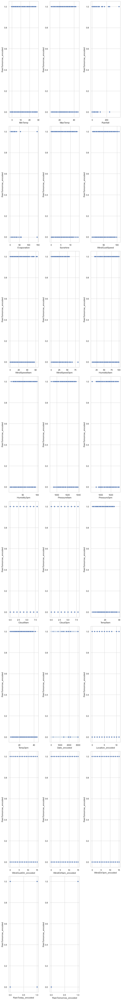

In [34]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.scatterplot(colist[x], y='RainTomorrow_encoded', data=final_dataframe)
        plt.tight_layout()
    except ValueError:
        continue

# It can be visualized from above scatter plots against outcome vector that 

## 1. distribution is mostly evenly distributed for most of the columns. For example, 

        Min Temp
        
        Max Temp
        
        Sunshine
        
        WindGustSpeed
        
        Cloud9am
        
        Cloud3pm
        
        WindGustDir_encoded
        
        WindDir9am_encoded
        
        WindDir3pm_encoded
        
        Rain Today
        
# Encoding Explained

## Yes is encoded as 1 and No as 0.
 

# Anomalies:

## 1. Amount of rainfall is higher for yes responses.

## 2. Highest Evaporation is observed for no responses.

## 3. WindSpeed9am is highest for yes responses.

## 4. WindSpeed3pm is highest for no responses

## 5. Humidity9am includes all the datapoints densely spred for no responses whereas yes responses cover only higher data points.


# Q&A Answered:

## 1. Range of cloud 3 pm: 0 to 9

## 2. Range of RainToday: 0 and 1

## 3.  Range of Humidity 9 am: 0 to 100

# Value Count Of all Primary Fuels.

In [34]:
data['RainTomorrow_encoded'].value_counts()

0.0    6259
1.0    2166
Name: RainTomorrow_encoded, dtype: int64

# Verbal Translation Of Above Value Counts

# Anomalies Detected: 
1. Of 2 responses, 1 occured 2166 times.
2. 0 occured maximum times, 6259.

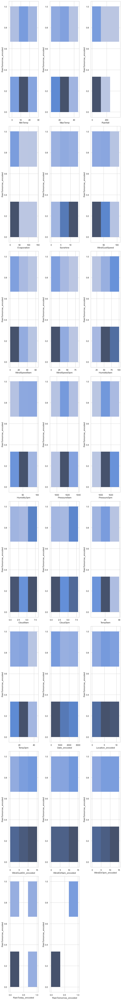

In [35]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(0,len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.histplot(x=colist[x], y='RainTomorrow_encoded', data=final_dataframe, bins=3)
        plt.tight_layout()
    except ValueError:
        continue

# The above histograms show frequency distribution of features against label. It is divided into 3 bins. ['Pressure9am', 'Humidity9am', 'Cloud9am', 'Cloud3pm','WindDir3pm_encoded', 'Pressure3pm', 'MinTemp', 'WindGustDir_encoded','Location_encoded', 'Temp9am', 'WindDir9am_encoded', 'Humidity3pm', 'MaxTemp', 'Date_encoded', 'Temp3pm', 'WindSpeed3pm', 'WindGustSpeed'] seem to be close to normal with skewness threshold within +/-0.65. Normal distribution has 0 skewness. 
## 1. The entire dataframe against rain tomorrow encoded has skewness 1.11 and kurtosis -0.76, indicating high abnormalities with Rain Tomorrow encoded as label. It reflects right skewed and platykurtic data.

## 2. High skewness is observed in:

        Rainfall                11.105533

        Evaporation             10.302798


# Action Plan From Above Anomalies:

    1. Requires outliers removal and transformation to save adequately informative data for predictive development.

    2. Requires data scaling to normalize the existing columns and hence removing abnormally widespread data points.

# Q&A Answered:

## 1. Feature that can cause bias: Rainfall and Evaporation
## 2. Feature that can be used to explain label: ['Pressure9am', 'Humidity9am', 'Cloud9am', 'Cloud3pm','WindDir3pm_encoded', 'Pressure3pm', 'MinTemp', 'WindGustDir_encoded','Location_encoded', 'Temp9am', 'WindDir9am_encoded', 'Humidity3pm', 'MaxTemp', 'Date_encoded', 'Temp3pm', 'WindSpeed3pm', 'WindGustSpeed']

# Correlation Analysis

# Mathematical Notation:
Correlation (X, Y) = (Covariance Of X and Covariance Of Y)/(Std Of X and Std Of Y)

In [45]:
final_dataframe.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
MinTemp,1.000000,0.719857,0.104892,0.142660,-0.000240,0.205978,0.137734,0.183564,-0.132351,0.082261,...,0.057409,0.888200,0.686459,0.015722,0.116543,-0.154196,-0.054128,-0.151081,0.076853,0.109964
MaxTemp,0.719857,1.000000,-0.059881,0.192325,0.286187,0.124478,0.012070,0.089743,-0.388780,-0.413465,...,-0.203363,0.868507,0.972916,0.103175,0.064048,-0.231331,-0.223008,-0.181747,-0.216353,-0.140427
Rainfall,0.104892,-0.059881,1.000000,0.261462,-0.130611,0.073911,0.048887,0.026858,0.209497,0.216646,...,0.125924,0.014773,-0.064982,0.050052,0.038412,0.049618,0.099318,0.028958,0.467754,0.264664
Evaporation,0.142660,0.192325,0.261462,1.000000,0.135373,0.079408,0.044152,0.073508,-0.082620,-0.088215,...,-0.027065,0.173205,0.189044,0.228004,0.150966,-0.000249,0.003961,-0.034610,0.051659,0.058667
Sunshine,-0.000240,0.286187,-0.130611,0.135373,1.000000,-0.150016,-0.142133,-0.068734,-0.241645,-0.354433,...,-0.478161,0.160567,0.307073,0.278673,0.118333,-0.064877,-0.059330,-0.035241,-0.213091,-0.292780
WindGustSpeed,0.205978,0.124478,0.073911,0.079408,-0.150016,1.000000,0.658227,0.654995,-0.294910,-0.122590,...,0.124382,0.182714,0.090147,-0.151802,0.196622,0.048609,-0.077983,0.040428,0.081352,0.173275
WindSpeed9am,0.137734,0.012070,0.048887,0.044152,-0.142133,0.658227,1.000000,0.562749,-0.358644,-0.112526,...,0.136086,0.108630,-0.003153,-0.086453,0.222325,-0.027897,-0.046379,0.027843,0.045912,0.078504
WindSpeed3pm,0.183564,0.089743,0.026858,0.073508,-0.068734,0.654995,0.562749,1.000000,-0.253077,-0.091454,...,0.085843,0.186996,0.064722,-0.053517,0.229900,0.062724,-0.014847,0.067427,0.036217,0.060499
Humidity9am,-0.132351,-0.388780,0.209497,-0.082620,-0.241645,-0.294910,-0.358644,-0.253077,1.000000,0.631196,...,0.248377,-0.377465,-0.380971,0.088439,0.006010,0.058384,0.083805,-0.014165,0.376489,0.277397
Humidity3pm,0.082261,-0.413465,0.216646,-0.088215,-0.354433,-0.122590,-0.112526,-0.091454,0.631196,1.000000,...,0.401880,-0.125526,-0.490290,-0.039559,0.056522,0.070751,0.151872,-0.020461,0.360540,0.448288


# The above table represents correlation among dataset. 
There seems some multicollinearity due to presence of 

Apart from this, there seems moderate multicollinearity among features:

    Max Temp and Min Temp
    
    Min Temp and Temp 9 am
    
    Min Temp and Temp 3 pm
    
    Max Temp and Temp 9 pm
    
    Max Temp and Temp 3 pm
    
    Humidity 3pm and Humidity 9 am

## Action Plan:
I will do further eda on Max Temp, Min Temp, Temp 9 am, Temp 3 pm, Humidity 3 pm and Humidity 9 am to gauge to weight biasness caused by it against its label explanation capacity.

# Graphical Translation Of Above Table

<AxesSubplot:>

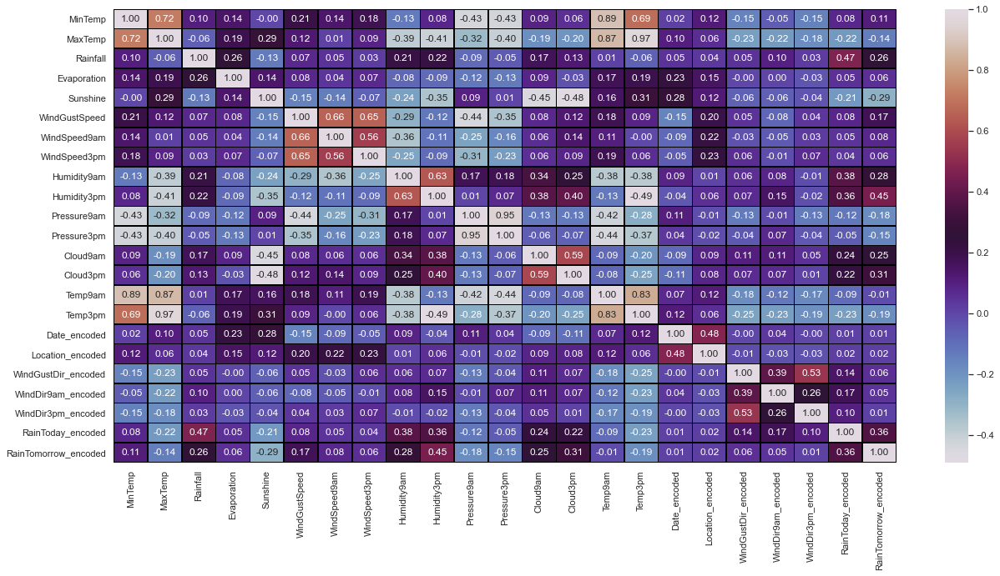

In [46]:
plt.figure(figsize=(21,10))
sns.heatmap(data.corr(), annot=True, linewidths=0.5, linecolor='black', fmt='.2f', cmap='twilight')

# Verbal Translation Of Above Graph:
# 1. Label has weak negative relationship with these features:

        MaxTemp, 
        
        Sunshine, 
        
        Pressure9am, 
        
        Pressure3pm, 
        
        Temp9am,
        
        Temp3pm           

# 2. Label has weak positive to strong positive relationship with these features in this heatmap:

        MinTemp, 
        
        Rainfall, 
        
        Evaporation, 
        
        WindGustSpeed, 
        
        WindSpeed9am,
        
        WindSpeed3pm, 
        
        Humidity9am, 
        
        Humidity3pm, 
        
        Cloud9am, 
        
        Cloud3pm,
        
        Date_encoded, 
        
        Location_encoded, 
        
        WindGustDir_encoded,
        
        WindDir9am_encoded, 
        
        WindDir3pm_encoded, 
        
        RainToday_encoded

# 3. Strong Multicollinearity is detected between:

        Max Temp and Min Temp
        
        Min Temp and Temp 9 am
        
        Min Temp and Tem 3 pm
        
        Max Temp and Temp 9 pm
        
        Max Temp and Temp 3 pm
        
        Humidity 3pm and Humidity 9 am


# 4. Multicollinearity seems to be moderate among all other data points.

# Graphical Representation Of Correlation Of Features With Label


In [47]:
import cufflinks as cf
cf.set_config_file(offline=True)
pd.DataFrame((final_dataframe.corr()['RainTomorrow_encoded'])).iplot(title='Correlation Of Variables With Label')

# The above iplot represents correlation of features with label. Correlation of features with label is of high relevance. The stronger the relationship of label with axis, the more accurate the prediction. In the above line graph:

# 1. Highest correlation with label is observed to be 44.83%, that is shared with Humidity 3 pm. Minimum correlation is 0.96%, that is shared with Date Encoded.

# 2. Weak Negative Relationship Is Found With Following Features:

        Sunshine      -0.292780
        
        Temp3pm       -0.186007
        
        Pressure9am   -0.180222
        
        Pressure3pm   -0.154643
        
        MaxTemp       -0.140427
        
        Temp9am       -0.012889


# 3. Weak Positive Relationship Is Found With Following Features:

        Date_encoded            0.009565
        
        WindDir3pm_encoded      0.012118
        
        Location_encoded        0.019760
        
        WindDir9am_encoded      0.046836
        
        Evaporation             0.058667
        
        WindGustDir_encoded     0.058938
        
        WindSpeed3pm            0.060499
        
        WindSpeed9am            0.078504
        
        MinTemp                 0.109964
        
        WindGustSpeed           0.173275
        
        Cloud9am                0.253365
        
        Rainfall                0.264664
        
        Humidity9am             0.277397
        
        Cloud3pm                0.311213
        
        RainToday_encoded       0.362629
        
        Humidity3pm             0.448288

# 4. Correlation Of Label with itself is of no relevance

# Data Handling Conclusion Of Correlation


# Overall correlation among dataset, There seems some multicollinearity due to presence of Max Temp and Min Temp; Min Temp and Temp 9 am; Min Temp and Temp 3 pm; Max Temp and Temp 9 pm; Max Temp and Temp 3 pm; Humidity 3pm and Humidity 9 am.We will do further eda before arriving at a conclusion to delete these columns.

# 1. The most useful feature is Humidity 3pm, apart from this, there seems modest correlation of features with label.

# 2. As a conclusion, we will do further cause and effect analysis based on skewness and distribution plots to conclude if we want to remove multicollinarity causing column:

## i. Min Temp
## ii. Max Temp
## iii. Temp 9 am 
## iv Temp 3 pm
## v. Humidity 9 am
    
# 3. Highest Bias (Multicollinearity) is observed in:
## i. Min Temp
## ii. Max Temp
## iii. Temp 9 am 
## iv Temp 3 pm
## v. Humidity 9 am

# Q&A Answered
## 1. Most useful feature for prediction: Humidity 3 pm
## 2. Most bias causing feature:
    ## i. Min Temp
    ## ii. Max Temp
    ## iii. Temp 9 am 
    ## iv Temp 3 pm
    ## v. Humidity 9 am


# Dataset Information Table


In [55]:
final_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   MinTemp               8425 non-null   float64
 1   MaxTemp               8425 non-null   float64
 2   Rainfall              8425 non-null   float64
 3   Evaporation           8425 non-null   float64
 4   Sunshine              8425 non-null   float64
 5   WindGustSpeed         8425 non-null   float64
 6   WindSpeed9am          8425 non-null   float64
 7   WindSpeed3pm          8425 non-null   float64
 8   Humidity9am           8425 non-null   float64
 9   Humidity3pm           8425 non-null   float64
 10  Pressure9am           8425 non-null   float64
 11  Pressure3pm           8425 non-null   float64
 12  Cloud9am              8425 non-null   float64
 13  Cloud3pm              8425 non-null   float64
 14  Temp9am               8425 non-null   float64
 15  Temp3pm              

# The above table reprents information dataset:
    
    i. Columns

    ii. Count Of Non Null Data Points

    iii. Values data type for each columns

    iv. Count of data types in iii.

    v. Memory Usage

   # It can be deduced that the dataset has 8425 rows and each column has no missing values. 
The datatypes used are float64. There 23 float64 columns. Memory usage is 1.5 MB.

# Names of all the columns

In [56]:
data.select_dtypes(include = [np.number]).columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded',
       'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded',
       'RainToday_encoded', 'RainTomorrow_encoded'],
      dtype='object')

# The above code cell highlights all numeric values, that will be used to derive following graphs.

# Box Plot To Detect Outliers

In [57]:
import plotly.express as px
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
import time
for x in colist:
    try:
        plot = px.box(data_frame=final_dataframe, x=x, y='RainTomorrow_encoded')
        plot.show()
    except ValueError:
        print('{} : Values Are Outside Scaling Region, try using skewness function to detect outlier'.format(x))        
        continue

# Verbal Translation Of Above Graph
1. The data seems to be biased, as analyzed above, example, Min Temp, etcetera. Hence, we will go through descriptive stats for further analysis.

# Descriptive Statistics

In [27]:
description=final_dataframe.describe()
description

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.00000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,...,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193329,23.874386,3.322944,7.153555,8.87378,37.655193,13.811751,18.455193,67.859941,51.272047,...,4.282849,17.770255,22.450493,1296.570564,5.793591,7.721662,7.656499,7.795490,0.256617,0.257092
std,5.398520,6.139857,11.865187,10.644472,3.27113,16.163866,10.181388,9.814225,16.809144,18.405299,...,2.849813,5.621854,5.960242,854.249434,3.162654,4.497233,4.529317,4.482193,0.436792,0.437056
min,-2.000000,8.200000,0.000000,0.000000,0.00000,7.000000,0.000000,0.000000,10.000000,6.000000,...,0.000000,1.900000,7.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.200000,19.300000,0.000000,3.800000,8.10000,26.000000,6.000000,11.000000,56.000000,39.000000,...,1.000000,13.800000,18.100000,589.000000,3.000000,4.000000,3.000000,4.000000,0.000000,0.000000
50%,13.300000,23.300000,0.000000,6.400000,9.20000,37.000000,13.000000,19.000000,68.000000,51.000000,...,5.000000,17.800000,21.900000,1088.000000,6.000000,8.000000,7.000000,8.000000,0.000000,0.000000
75%,17.400000,28.100000,1.200000,8.000000,11.10000,48.000000,20.000000,24.000000,80.000000,63.000000,...,7.000000,22.000000,26.400000,2021.000000,8.000000,12.000000,12.000000,11.000000,1.000000,1.000000
max,28.500000,45.500000,371.000000,145.000000,13.90000,107.000000,63.000000,83.000000,100.000000,99.000000,...,8.000000,39.400000,44.100000,3003.000000,11.000000,15.000000,15.000000,15.000000,1.000000,1.000000


In [28]:
lst=description.columns.to_list()
print(lst)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded', 'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded', 'RainToday_encoded', 'RainTomorrow_encoded']


In [29]:
lst1=[]
for x in range(len(lst)):
    lst1.append([description.iloc[6,x]-description.iloc[5,x]])
len(lst1), print(lst1)

[[4.099999999999998], [4.800000000000001], [1.2], [1.5999999999999996], [1.9000000000000004], [11.0], [7.0], [5.0], [12.0], [12.0], [2.1000000000000227], [2.5], [2.0], [2.0], [4.199999999999999], [4.5], [933.0], [2.0], [4.0], [5.0], [3.0], [1.0], [1.0]]


(23, None)

In [30]:
lst1_frame=pd.DataFrame(data=lst1, index=lst, columns=['IQR'])
lst1_frame=lst1_frame.T
lst1_frame

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
IQR,4.1,4.8,1.2,1.6,1.9,11.0,7.0,5.0,12.0,12.0,...,2.0,4.2,4.5,933.0,2.0,4.0,5.0,3.0,1.0,1.0


In [31]:
lst3=[]
for x in range(len(lst)):
    lst3.append([description.iloc[7,x]-description.iloc[3,x]])
len(lst3), print(lst3)

[[30.5], [37.3], [371.0], [145.0], [13.9], [100.0], [63.0], [83.0], [90.0], [93.0], [49.200000000000045], [53.10000000000002], [8.0], [8.0], [37.5], [36.800000000000004], [3003.0], [11.0], [15.0], [15.0], [15.0], [1.0], [1.0]]


(23, None)

In [32]:
lst3_frame=pd.DataFrame(data=lst3, index=lst, columns=['Range'])
lst3_frame=lst3_frame.T
lst3_frame

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
Range,30.5,37.3,371.0,145.0,13.9,100.0,63.0,83.0,90.0,93.0,...,8.0,37.5,36.8,3003.0,11.0,15.0,15.0,15.0,1.0,1.0


In [33]:
lst5=pd.DataFrame(data=final_dataframe.skew().to_list(), index=lst, columns=['Skewness'])
lst5=lst5.T
lst6=pd.DataFrame(data=final_dataframe.kurtosis().to_list(), index=lst, columns=['Kurtosis'])
lst6=lst6.T
lst5, lst6

(           MinTemp   MaxTemp   Rainfall  Evaporation  Sunshine  WindGustSpeed  \
 Skewness -0.091183  0.376325  11.105533    10.302798 -1.223477       0.506454   
 
           WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  ...  Cloud3pm  \
 Skewness       0.95422      0.494839    -0.258077     0.124258  ... -0.099767   
 
            Temp9am   Temp3pm  Date_encoded  Location_encoded  \
 Skewness -0.018532  0.392189       0.38656         -0.050456   
 
           WindGustDir_encoded  WindDir9am_encoded  WindDir3pm_encoded  \
 Skewness            -0.089944           -0.001343           -0.097025   
 
           RainToday_encoded  RainTomorrow_encoded  
 Skewness           1.114674              1.111827  
 
 [1 rows x 23 columns],
            MinTemp   MaxTemp    Rainfall  Evaporation  Sunshine  \
 Kurtosis -0.580951 -0.268565  215.835585   126.006929  0.807064   
 
           WindGustSpeed  WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  \
 Kurtosis       0.134548      1.07

# Outcome Table Of Descriptive Statistics

In [34]:
description1=pd.concat([description, lst1_frame, lst3_frame, lst5, lst6])
description1

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,...,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193329,23.874386,3.322944,7.153555,8.873780,37.655193,13.811751,18.455193,67.859941,51.272047,...,4.282849,17.770255,22.450493,1296.570564,5.793591,7.721662,7.656499,7.795490,0.256617,0.257092
std,5.398520,6.139857,11.865187,10.644472,3.271130,16.163866,10.181388,9.814225,16.809144,18.405299,...,2.849813,5.621854,5.960242,854.249434,3.162654,4.497233,4.529317,4.482193,0.436792,0.437056
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,...,0.000000,1.900000,7.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.200000,19.300000,0.000000,3.800000,8.100000,26.000000,6.000000,11.000000,56.000000,39.000000,...,1.000000,13.800000,18.100000,589.000000,3.000000,4.000000,3.000000,4.000000,0.000000,0.000000
50%,13.300000,23.300000,0.000000,6.400000,9.200000,37.000000,13.000000,19.000000,68.000000,51.000000,...,5.000000,17.800000,21.900000,1088.000000,6.000000,8.000000,7.000000,8.000000,0.000000,0.000000
75%,17.400000,28.100000,1.200000,8.000000,11.100000,48.000000,20.000000,24.000000,80.000000,63.000000,...,7.000000,22.000000,26.400000,2021.000000,8.000000,12.000000,12.000000,11.000000,1.000000,1.000000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,...,8.000000,39.400000,44.100000,3003.000000,11.000000,15.000000,15.000000,15.000000,1.000000,1.000000
IQR,4.100000,4.800000,1.200000,1.600000,1.900000,11.000000,7.000000,5.000000,12.000000,12.000000,...,2.000000,4.200000,4.500000,933.000000,2.000000,4.000000,5.000000,3.000000,1.000000,1.000000
Range,30.500000,37.300000,371.000000,145.000000,13.900000,100.000000,63.000000,83.000000,90.000000,93.000000,...,8.000000,37.500000,36.800000,3003.000000,11.000000,15.000000,15.000000,15.000000,1.000000,1.000000


# Graphical Representation Of Above Table


In [35]:
final_dataframe.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded',
       'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded',
       'RainToday_encoded', 'RainTomorrow_encoded'],
      dtype='object')

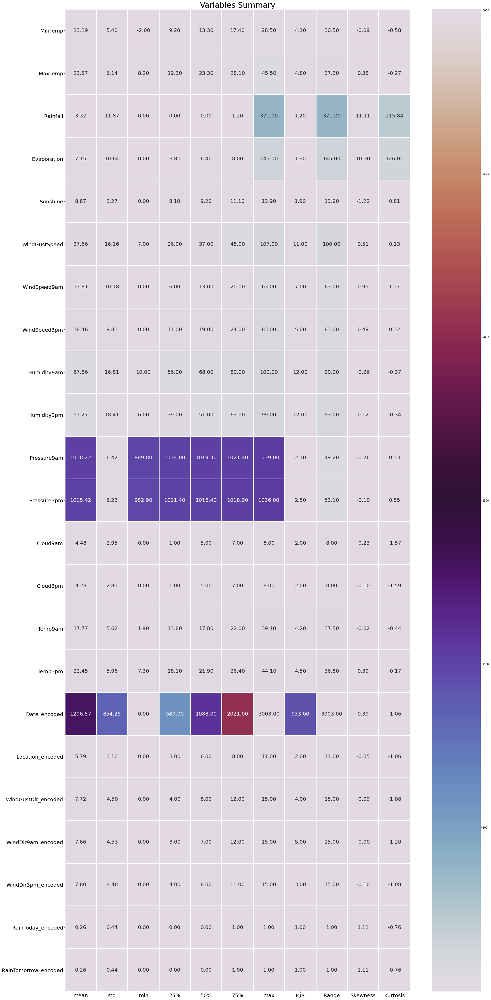

In [55]:
import numpy as np
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(30,70))
sns.heatmap(round(description1[1:].transpose(),2), linewidth=2, annot=True, fmt='.2f', square=False, cmap='twilight',annot_kws={'fontsize':20} )
plt.xticks(fontsize=20, color='black')
plt.yticks(fontsize=20, color='black', rotation=360)
plt.title('Variables Summary', fontsize=30, pad=3)
plt.show()

# Mathematical Notation:
1. Mean = sum of values/count of values                                                                                     
2. std = sqrt(((value - mean of distribution)**2 / number of values ))                                                                                        
3. 3 quartile are measures of variance, calculated to spot the placeholder value, it returns index of the produced value.
Step 1: sort the dataset                                                                                                   
Step2:                                                                                                                     
i) Lower Quartile (Q1: 25% distribution) = ((number of values+1)/4)th Term                                                 
ii) Middle Quartile (Q2: 50% distribution) = ((number of values +1)/2)th Term                                               
Also, know as median (central value).                                                                                       
iii) Upper Quartile (Q3: 75% distribution) = ¾(number of values + 1)th Term                                                 
iv) IQR = Upper Quartile - Lowe Quartile                                                                                   
4. Range = Maximum Value - Minimum Value                                                                                   
5. Skewness = (sumation(value - mean of distribution)**3)/((number of values - 1) * std**3)                                 
6. Kurtosis = number of values * ((sumation(value - mean of distribution)**4) / std**4)

# Verbal Translation Of Descriptive Table And Graphic
1. For values that are scaled upto 1, mean is mostly around 0 and standard deviation is comparatively low. Hence, making the data much more acceptable by algorithms to process it more accurately.

2. The entire dataset ranges from -2 till 3003.0.

3. IQR, Range and Skewness and kurtosis are much more condensed in data that is scaled upto 1.


4. The entire dataframe against rain tomorrow encoded has skewness 1.11 and kurtosis -0.76, indicating high abnormalities with rainfall tomorrow encoded as label. It reflects right skewed and platykurtic data.

5. Skewness is 0 and within +/- 0.65 for:
        
        Humidity3pm              0.124258
        
        MaxTemp                  0.376325
        
        Date_encoded             0.386560
        
        Temp3pm                  0.392189
        
        WindSpeed3pm             0.494839
        
        WindGustSpeed            0.506454
        
        Pressure9am           -0.264378
        
        Humidity9am           -0.258077
        
        Cloud9am              -0.234198
        
        Cloud3pm              -0.099767
        
        WindDir3pm_encoded    -0.097025
        
        Pressure3pm           -0.096828
        
        MinTemp               -0.091183
        
        WindGustDir_encoded   -0.089944
        
        Location_encoded      -0.050456
        
        Temp9am               -0.018532
        
        WindDir9am_encoded    -0.001343
    
6. High skewness is observed in:
        
        RainTomorrow_encoded     1.111827
        
        RainToday_encoded        1.114674
        
        Evaporation             10.302798
        
        Rainfall                11.105533
        
        Sunshine              -1.223477

7. Acceptable skewness is +/- 0.65 and skewness for bell shaped curve should be 0.

8. Kutosis is upto 3 for most dataset, indicating platykurtic curves.

9. Kurtosis is greater than 3, indicating, leptokurtic curve for:

        Evaporation    126.006929
        
        Rainfall       215.835585

8. Kurtosis for bell shaped curve should be 3.

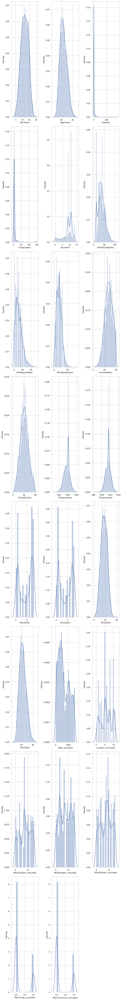

In [53]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(0,len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.distplot(final_dataframe[colist[x]])
        plt.tight_layout()
    except ValueError:
        continue

# Observations

# 1. Acceptable skewness is +/-0.65 and Correct skewness for bell shaped curve is 0


# 2. Acceptable And Outliers Prone Right Skewness is observed in:
         
         Humidity3pm              0.124258

         MaxTemp                  0.376325

         Date_encoded             0.386560

         Temp3pm                  0.392189

         WindSpeed3pm             0.494839

         WindGustSpeed            0.506454
         
          RainTomorrow_encoded     1.111827

         RainToday_encoded        1.114674

         Evaporation             10.302798

         Rainfall                11.105533
        
# 3. Acceptable And Outliers Prone Left Skewness is observed in:
        
         Pressure9am           -0.264378

         Humidity9am           -0.258077

         Cloud9am              -0.234198

         Cloud3pm              -0.099767

         WindDir3pm_encoded    -0.097025

         Pressure3pm           -0.096828

         MinTemp               -0.091183

         WindGustDir_encoded   -0.089944

         Location_encoded      -0.050456

         Temp9am               -0.018532

         WindDir9am_encoded    -0.001343

         Sunshine              -1.223477
        

# Conclusion:

# Based On EDA done above in two parts, I will do f test and ptest on these biased columns:

 1. Evaporation (Skewness and Kurtosis)

 2. Rainfall   (Skewness and Kurtosis) 
 
 3. Temp 3 pm  (Kurtosis and Multicollinearity)


# Error Removal And Data Handling


# ANOVA Test On Selected Features
## Ftest score should be greater than 1 and p value should be less than 0.05, to determine to keep these features for further analysis

In [68]:
final_dataframe.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded',
       'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded',
       'RainToday_encoded', 'RainTomorrow_encoded'],
      dtype='object')

# Columns1: Evaporation

In [69]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['Evaporation'], final_dataframe['RainTomorrow_encoded'])
f,p

(3530.554734361494, 0.0)

In [ ]:
final_dataframe.columns

# Column 2: Rainfall

In [70]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['Rainfall'], final_dataframe['RainTomorrow_encoded'])
f,p

(561.7384104781363, 3.4911938962066584e-122)

# Column 3: Temp 3 PM

In [72]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['Temp3pm'], final_dataframe['RainTomorrow_encoded'])
f,p

(116187.8757343689, 0.0)

Error Removal And Data Handling
Based on above analysis:
1. There are no outliers in the data.
2. Strong multicolliearity features are important for prediction because there f test and p value are acceptable. This means that the amount of multicollineaity is insignificant and removing the feature will lower explanatory capacity of the model.
3. Extereme leptokurtic and right skewed features are also relatively significant based on f test and p test.
4. Extreme platykurtic and left skewed features are also relatively significant based on f test and p test.


## Hence, as a solution, feature scaling will do a better job in explaining the dependent variable than removing whole columns.

## Prior to feature scaling, I will put the features through vif test and outliers transformation for better training of the model.


In [74]:
# Z Score: Outliers Treatment

In [75]:
import numpy as np
from scipy.stats import stats
from sklearn.preprocessing import StandardScaler
scaled = StandardScaler()
scaled.fit(final_dataframe)
scaled_data = scaled.transform(final_dataframe)
score=np.abs(stats.zscore(scaled_data))
score.shape

(8425, 23)

In [56]:
#threshold=(-3,3)
threshold=3
print(np.where(score>3))

(array([  12,   12,   44,   44,   52,   52,   60,   60,   61,   61,   62,
         62,   67,   68,   68,  123,  296,  381,  381,  405,  406,  407,
        407,  431,  462,  563,  568,  683,  683,  699,  713,  748,  748,
        796,  797,  802,  928,  949,  979,  980,  980,  980, 1008, 1009,
       1011, 1138, 1148, 1149, 1151, 1189, 1237, 1241, 1264, 1265, 1357,
       1411, 1412, 1479, 1480, 1481, 1513, 1535, 1587, 1644, 1665, 1673,
       1680, 1774, 1898, 1903, 1945, 2016, 2028, 2042, 2043, 2074, 2116,
       2186, 2199, 2200, 2201, 2219, 2219, 2230, 2231, 2265, 2505, 2527,
       2527, 2541, 2593, 2676, 2677, 2735, 2859, 2890, 2898, 2900, 3003,
       3051, 3051, 3058, 3059, 3059, 3066, 3067, 3067, 3067, 3068, 3082,
       3082, 3082, 3089, 3089, 3099, 3099, 3141, 3153, 3167, 3172, 3173,
       3174, 3175, 3176, 3177, 3178, 3200, 3201, 3202, 3203, 3204, 3205,
       3206, 3212, 3212, 3230, 3230, 3231, 3231, 3232, 3232, 3233, 3233,
       3234, 3234, 3235, 3235, 3236, 3236, 3237, 3

# The cell above displays outlier values.


In [57]:
len(np.where(score>3)[0])

506

# The cell above shows number of outliers.


In [58]:
data_new=final_dataframe[(score<3).all(axis=1)]
data_new

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,13.0,13.0,14.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,14.0,6.0,15.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,15.0,13.0,15.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,9.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,13.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2.8,23.4,0.0,5.6,8.6,31.0,13.0,11.0,51.0,24.0,...,2.0,10.1,22.4,2999.0,9.0,0.0,9.0,1.0,0.0,0.0
8421,3.6,25.3,0.0,5.6,8.6,22.0,13.0,9.0,56.0,21.0,...,2.0,10.9,24.5,3000.0,9.0,6.0,9.0,3.0,0.0,0.0
8422,5.4,26.9,0.0,5.6,8.6,37.0,9.0,9.0,53.0,24.0,...,2.0,12.5,26.1,3001.0,9.0,3.0,9.0,14.0,0.0,0.0
8423,7.8,27.0,0.0,5.6,8.6,28.0,13.0,7.0,51.0,24.0,...,2.0,15.1,26.0,3002.0,9.0,9.0,10.0,3.0,0.0,0.0


# The table above shows the final dataframe after removing outliers, 
506 rows are removed and resultant dimension is 8041 rows * 23 columns

# IQR Method Of Outliers Removal

# Since, all rows are removed by z method, hence, I will try IQR Method of outliers removal and power transformation method of outliers transformation.

In [59]:
Q1= final_dataframe[final_dataframe.columns].quantile(0.25)
Q3 = final_dataframe[final_dataframe.columns].quantile(0.75)
IQR = Q3 - Q1
upper_limit = Q3 + 1.5 * IQR
lower_limit = Q1 - 1.5 * IQR

# The above code calculates IQR as discussed in descriptive statistics section of eda. 
It calculates Upper Limit and Lower Limit of distribution curve.

In [60]:
final_dataframe[(final_dataframe[final_dataframe.columns] < lower_limit) | (final_dataframe[final_dataframe.columns] > upper_limit)] # outliers

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8421,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8422,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8423,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# The above table displays, outliers detected by IQR Method, it displays all values beyond upper and lower limit and places 
NaN on all the values that are significant and within upper and lower limits.

In [61]:
new_df = final_dataframe[(final_dataframe[final_dataframe.columns] > lower_limit) & (final_dataframe[final_dataframe.columns] < upper_limit)]

In [62]:
new_df=new_df.fillna(method='bfill')
new_df

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,13.0,13.0,14.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,14.0,6.0,15.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,15.0,13.0,15.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,9.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,13.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2.8,23.4,0.0,5.6,8.6,31.0,13.0,11.0,51.0,24.0,...,2.0,10.1,22.4,2999.0,9.0,0.0,9.0,1.0,0.0,0.0
8421,3.6,25.3,0.0,5.6,8.6,22.0,13.0,9.0,56.0,21.0,...,2.0,10.9,24.5,3000.0,9.0,6.0,9.0,3.0,0.0,0.0
8422,5.4,26.9,0.0,5.6,8.6,37.0,9.0,9.0,53.0,24.0,...,2.0,12.5,26.1,3001.0,9.0,3.0,9.0,14.0,0.0,0.0
8423,7.8,27.0,0.0,5.6,8.6,28.0,13.0,7.0,51.0,24.0,...,2.0,15.1,26.0,3002.0,9.0,9.0,10.0,3.0,0.0,0.0


# The above table displays the final dataframe after IQR  treatment, since this method restores all the rows. 
It signifies that outliers are not very much spread and can be treated with power transform method.

# I prefer Power Transform in this case because outliers are not very significant in particular fuel types.

# It would be prudent to perform outliers transformation of remaining data for better pre processing.

# Vectorization

# I have divided the datset into X and Y vectors by removing label and its transformation from features vector.

Label vector is RainTomorrow_encoded.

In [64]:
x=final_dataframe.drop(['RainTomorrow_encoded'], axis=1)
y=final_dataframe['RainTomorrow_encoded']
x.sample()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded
8312,19.8,31.3,0.0,7.2,10.2,33.0,6.0,26.0,91.0,54.0,...,2.0,2.0,23.8,29.5,1337.0,4.0,7.0,1.0,14.0,0.0


# The above table displays a sample of features vector.

In [65]:
y.sample()

5861    1.0
Name: RainTomorrow_encoded, dtype: float64

# The above series displays a sample of label series.


# Outliers Transformation With Power Transform


In [66]:
from sklearn.preprocessing import power_transform
x_array=power_transform(x, method='yeo-johnson')
x_frame=pd.DataFrame(x_array, columns=x.columns)
x_frame

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded
0,0.041346,-0.078338,0.528185,0.684544,-0.14131,0.479891,0.719692,0.618232,0.151438,-1.642881,...,1.148325,-0.726309,-0.147947,-0.028164,-2.463238,-1.572870,1.141146,1.137729,1.330515,-0.587539
1,-1.072370,0.277744,-0.689415,0.684544,-0.14131,0.479891,-0.976829,0.433933,-1.396235,-1.459267,...,0.852215,-0.726309,-0.094603,0.383337,-2.434742,-1.572870,1.338463,-0.284551,1.527379,-0.587539
2,-0.051148,0.371387,-0.689415,0.684544,-0.14131,0.591205,0.641096,0.797573,-1.707261,-1.160952,...,0.852215,-0.726309,0.578038,0.205637,-2.412661,-1.572870,1.533489,1.137729,1.527379,-0.587539
3,-0.737288,0.717966,-0.689415,0.684544,-0.14131,-0.812406,-0.081304,-0.943935,-1.343091,-2.023204,...,0.852215,1.224025,0.065206,0.724439,-2.393929,-1.572870,-0.786986,0.356295,-1.869512,-0.587539
4,0.798119,1.319968,0.882361,0.684544,-0.14131,0.308107,-0.542338,0.244088,0.840363,-0.985937,...,0.852215,1.224025,0.011973,1.190736,-2.377348,-1.572870,1.141146,-1.565279,-0.123884,-0.587539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,-1.934408,0.004437,-0.689415,0.051862,-0.28837,-0.314843,0.118575,-0.703453,-1.016891,-1.520051,...,-0.430777,-0.726309,-1.368923,0.073130,1.651834,1.002532,-1.845772,0.356295,-1.575489,-0.587539
8421,-1.783703,0.309115,-0.689415,0.051862,-0.28837,-0.967244,0.118575,-0.943935,-0.735966,-1.704970,...,-0.430777,-0.726309,-1.223911,0.415112,1.652556,1.002532,-0.326047,0.356295,-1.052861,-0.587539
8422,-1.445965,0.554573,-0.689415,0.051862,-0.28837,0.069069,-0.299606,-0.943935,-0.905478,-1.520051,...,-0.430777,-0.726309,-0.935105,0.663753,1.653279,1.002532,-1.029224,0.356295,1.330515,-0.587539
8423,-0.997822,0.569601,-0.689415,0.051862,-0.28837,-0.520541,0.118575,-1.201499,-1.016891,-1.520051,...,-0.430777,-0.726309,-0.468835,0.648493,1.654001,1.002532,0.324559,0.558233,-1.052861,-0.587539


# The above table displays outliers transformed values as discussed above.

In [67]:
x_frame[np.isinf(x_frame)] = 0
x_frame[np.isnan(x_frame)]=0

# In the above cell, I have filled infinite and na values with 0, in case those arose during the process of transformation.

In [68]:
from sklearn.preprocessing import MinMaxScaler
scaled = MinMaxScaler([0,1])
scaled.fit(x_frame)
scaled_data = scaled.transform(x_frame)
scaled_data

array([[0.5106594 , 0.52224809, 0.47610571, ..., 0.89189853, 0.94204575,
        0.        ],
       [0.31433142, 0.57945788, 0.        , ..., 0.47448676, 1.        ,
        0.        ],
       [0.49435441, 0.59450286, 0.        , ..., 0.89189853, 1.        ,
        0.        ],
       ...,
       [0.24847333, 0.62393443, 0.        , ..., 0.66256265, 0.94204575,
        0.        ],
       [0.32747289, 0.62634894, 0.        , ..., 0.72182761, 0.24041139,
        0.        ],
       [0.55952472, 0.62634894, 0.        , ..., 0.18468389, 0.16571082,
        0.        ]])

# In the above cell, I have done positive scaling of features to make positive prediction. 
I have taken range of 0 to 1 because that is classification  range, hence, model performance can be sound.

In [69]:
x_frame1=pd.DataFrame(scaled_data, columns=x_frame.columns)

In [70]:
x_frame1.values.max()

1.0000000000000002

# Converted array into dataframe with labelled columns and checked maximum value to ensure that no inf values are remaining.

# Variance Inflation Factor

In [71]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(scaled_data, w) for w in range(scaled_data.shape[1])]
vif['Features']=x_frame1.columns
vif=vif.sort_values(ascending=False, by='vif')
vif

,vif,Features
11,396.918643,Pressure3pm
15,362.743094,Temp3pm
1,317.712828,MaxTemp
10,296.083960,Pressure9am
14,167.515472,Temp9am
0,67.787594,MinTemp
9,41.106284,Humidity3pm
8,38.974842,Humidity9am
3,20.379765,Evaporation
5,18.201826,WindGustSpeed


In [72]:
drop_features=vif[vif['vif']>6]
drop_features

,vif,Features
11,396.918643,Pressure3pm
15,362.743094,Temp3pm
1,317.712828,MaxTemp
10,296.083960,Pressure9am
14,167.515472,Temp9am
0,67.787594,MinTemp
9,41.106284,Humidity3pm
8,38.974842,Humidity9am
3,20.379765,Evaporation
5,18.201826,WindGustSpeed


In [86]:
#features_lst=drop_features['Features'].values
x_frame11=x_frame1.drop(drop_features['Features'][:17].to_list(), axis=1)
X_scaled=np.array(x_frame11)
#x=x.drop(features_lst, axis=1)
new_vif=pd.DataFrame()
new_vif['vif']=[variance_inflation_factor(X_scaled, w) for w in range(X_scaled.shape[1])]
new_vif['Features']=x_frame11.columns
new_vif=new_vif.sort_values(ascending=False, by='vif')
new_vif

,vif,Features
1,5.653413,Cloud3pm
0,5.562913,Cloud9am
3,4.291250,WindDir9am_encoded
4,4.036254,WindDir3pm_encoded
2,3.570919,Location_encoded


# Since, all the vif scores are below 6, I can pass the listed features for feature selection

# Data Handling Conclusion

# Concluding Points:
# 1. As part of data handling, I have transformed features with high outliers (by analyzing box plots, dist plots, variable plot, scatter plots and descriptive plots).                            

# 2. I have removed multicollinearity by analyzing correlation, correlation heatmaps and variance inflation factor.                                                                  
# 3. Hence, the model can be expected to be low bias model.

# Feature Selection


In [88]:
from sklearn.feature_selection import f_classif, f_regression
from sklearn.feature_selection import SelectKBest, SelectPercentile
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.feature_selection import VarianceThreshold

In [89]:
x.shape, y.shape

((8425, 22), (8425,))

In [91]:
Xf_train, Xf_test, Y_train, Y_test=train_test_split(x_frame11,y,test_size=0.30)

# In the above cell, 
I have checked final shape of each vector and splitted the dat ainto 30% test and 70% train.

In [92]:
constant_filter=VarianceThreshold(threshold=0.01)
constant_filter.fit(Xf_train)
Xf_train_filter=constant_filter.transform(Xf_train)
Xf_test_filter=constant_filter.transform(Xf_test)

# In the above code, I have put the values in Variance Threshold Filter and transformed those. To ensure low variance, I have taken variance threshold of 0.01.

<AxesSubplot:>

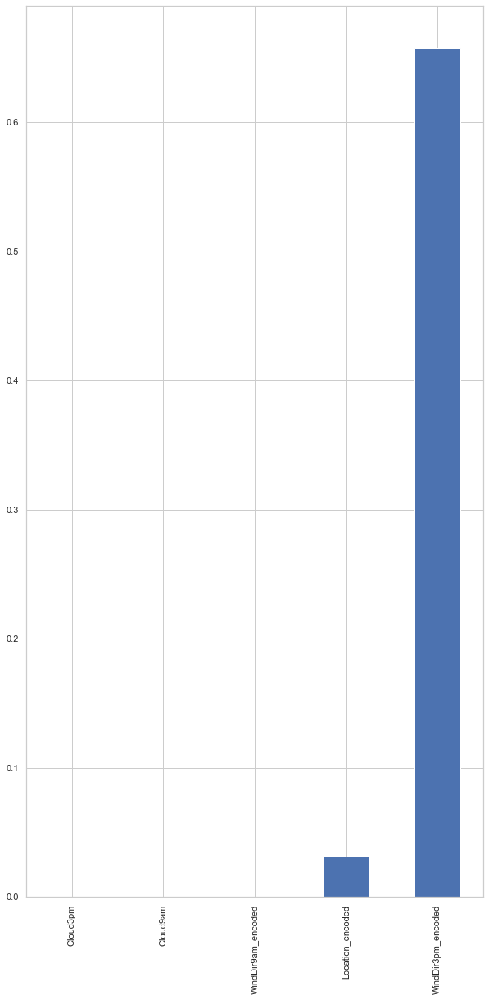

In [94]:
sel=f_classif(Xf_train, Y_train)
p_values=pd.Series(sel[1])
p_values.index=Xf_train.columns
p_values.sort_values(ascending=True, inplace=True)
p_values.plot.bar(figsize=(10,20))

In [76]:
# I have used these transformed values to generate pvalue of each feature (to explain label).

# Mathematical Notation

P Value = (sample proportion - Assumed population proportion in the null hypothesis)/(sqrt((Assumed population proportion in the null hypothesis * ( 1 - Assumed population proportion in the null hypothesis )) / n))

In [96]:
p_values=p_values[p_values<0.05]
p_values.index

Index(['Cloud3pm', 'Cloud9am', 'WindDir9am_encoded', 'Location_encoded'], dtype='object')

# These features strongly impact attrition and control actions are required mainly on these 
to curb the problems around attrition.

# P Values are an important component of feature selection, with significance level set to 0.05, Variance Threshold
    ensemble technique returns with 95% confidence, all the features that have maximum explanatory capacity
For the present dataset features with pvalues with less than 0.05 are:
Index(['Cloud3pm', 'Cloud9am', 'WindDir9am_encoded', 'Location_encoded'], dtype='object')

In [97]:
import numpy as np
x=x_frame1.copy()
x=x[['Cloud3pm', 'Cloud9am', 'WindDir9am_encoded', 'Location_encoded']]
x.sample()

,Cloud3pm,Cloud9am,WindDir9am_encoded,Location_encoded
1134,0.902643,0.15687,0.337314,0.315438


# The above table displays a sample of final x vector with features and values finally selected to be used for prediction.

In [98]:
y.sample()

4527    0.0
Name: RainTomorrow_encoded, dtype: float64

# The above series displays a sample of label.

In [99]:
x.shape, y.shape

((8425, 4), (8425,))

# The above cell displays final shapes of x and y vectors

In [102]:
x_train, x_test, y_train, y_test=train_test_split(x,y,test_size=0.3)

In [103]:
x_train.shape, y_train.shape

((5897, 4), (5897,))

# In the above two cells, I have divided final vectors with train test split technique, in which train data is 70% and test data is 30% to avoid overfitting issue.

# Model Development, Evaluation And Saving (Total Models = 10)

# Selection Reasoning Of Models 1 to 5

# The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve generalizability / robustness over a single estimator.

Two families of ensemble methods are usually distinguished:

In averaging methods, the driving principle is to build several estimators independently and then to average their predictions. On average, the combined estimator is usually better than any of the single base estimator because its variance is reduced.

Examples: Bagging methods, Forests of randomized trees, etcetera

By contrast, in boosting methods, base estimators are built sequentially and one tries to reduce the bias of the combined estimator. The motivation is to combine several weak models to produce a powerful ensemble.

Examples: AdaBoost, Gradient Tree Boosting,etcetera

# The use case assigned revolves around uneven label points hence there
is high probality of not achieving a good fit. Hence, I have tried different ensembele techniques that 
can lower variance and bias and help achieve a goodness of fit. (Just as a reminder,
I have already applied variance threshold of 0.01 to ensure that risk of models is low). 

# The theories in the two cells above explain why I have chosen Model 1, 
Model 2, Model 3, Model 4 and Model 5 for this use case. Model 5 is support vector classifier 
and hence, is again a very powerful 
implementation to prevent illness of fit and make appropriate decision boundaries.

# Model 1

# Random Forest Classifier With Intuitional Hyper Parameter Tuning

In [104]:
from sklearn.ensemble import RandomForestClassifier as el
from sklearn.model_selection import cross_val_score
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
import matplotlib.pyplot as plt
import pickle
rfc=el(200, criterion='entropy', random_state=100, max_features='sqrt', min_weight_fraction_leaf=0.1, min_impurity_decrease=0.01, n_jobs=-1, warm_start=True, max_depth=30, max_leaf_nodes=10, ccp_alpha=1, oob_score=True, bootstrap=True)
rfc.fit(x_train, y_train)
model1_train_score=rfc.score(x_train, y_train)
model1_test_score=rfc.score(x_test, y_test)
scores=cross_val_score(rfc, x, y, cv=5)
cv_scores=scores.mean()
cv_risk=scores.std()
y_pred=rfc.predict(x_train)
ytst_pred=rfc.predict(x_test)
model1_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred})
model1_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred})

In [105]:
# Model 1 Predictions

In [106]:
model1_prediction_train

,y_train,yhat
220,0.0,0.0
3465,1.0,0.0
4976,0.0,0.0
6754,1.0,0.0
4627,0.0,0.0
...,...,...
3176,1.0,0.0
6761,1.0,0.0
3246,1.0,0.0
4843,1.0,0.0


In [107]:
model1_prediction_test

,y_test,yhat
1664,0.0,0.0
6415,0.0,0.0
6721,0.0,0.0
3797,0.0,0.0
4988,0.0,0.0
...,...,...
5279,0.0,0.0
1721,0.0,0.0
164,0.0,0.0
1015,0.0,0.0


In [108]:
# Model 1 Metrics

In [109]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(rfc.score(x_train, y_train),2))
print('Test Score: ', np.round(rfc.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test,ytst_pred),2))
print('Cross Validation Score: ', np.round(cv_scores,2))
print('Cross Validation Risk: ', np.round(cv_risk,2))
#Since risk is low model is low variance and since train score and test score are equivalent, model is low bias too.

Train Score:  0.75
Test Score:  0.73
Train Accuracy Score:  0.75
Test Accuracy Score:  0.73
Cross Validation Score:  0.74
Cross Validation Risk:  0.0


In [110]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test,ytst_pred))

              precision    recall  f1-score   support

         0.0       0.73      1.00      0.85      1853
         1.0       0.00      0.00      0.00       675

    accuracy                           0.73      2528
   macro avg       0.37      0.50      0.42      2528
weighted avg       0.54      0.73      0.62      2528



In [111]:
print(confusion_matrix(y_test,ytst_pred))

[[1853    0]
 [ 675    0]]


In [112]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred), 2)
    print(auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

0.5


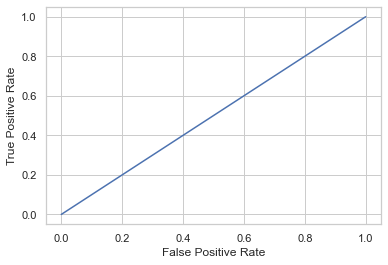

In [113]:
from sklearn import metrics
y_pred_proba =rfc.predict_proba(x_test)[::,1]
try:
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')

# Model 2

# Random Forest Classifier With Default Hyper Parameter Tuning

In [114]:
from sklearn.ensemble import RandomForestClassifier as el
from sklearn.model_selection import cross_val_score
rfc1=el()
rfc1.fit(x_train, y_train)
model2_train_score=rfc1.score(x_train, y_train)
model2_test_score=rfc1.score(x_test, y_test)
scores1=cross_val_score(rfc1, x, y, cv=5)
cv_scores1=scores1.mean()
cv_risk1=scores1.std()
y_pred1=rfc1.predict(x_train)
ytst_pred1=rfc1.predict(x_test)
model2_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred1})
model2_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred1})

In [115]:
 # Model 2 Predictions

In [116]:
model2_prediction_train

,y_train,yhat
220,0.0,0.0
3465,1.0,1.0
4976,0.0,0.0
6754,1.0,0.0
4627,0.0,0.0
...,...,...
3176,1.0,0.0
6761,1.0,0.0
3246,1.0,1.0
4843,1.0,1.0


In [117]:
model2_prediction_test

,y_test,yhat
1664,0.0,0.0
6415,0.0,0.0
6721,0.0,0.0
3797,0.0,0.0
4988,0.0,1.0
...,...,...
5279,0.0,0.0
1721,0.0,1.0
164,0.0,0.0
1015,0.0,1.0


In [118]:
# Model 2 Metrics

In [119]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(rfc1.score(x_train, y_train),2))
print('Test Score: ', np.round(rfc1.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred1),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred1),2))
print('Cross Validation Score: ', np.round(cv_scores1,2))
print('Cross Validation Risk: ', np.round(cv_risk1,2))

Train Score:  0.86
Test Score:  0.76
Train Accuracy Score:  0.86
Test Accuracy Score:  0.76
Cross Validation Score:  0.69
Cross Validation Risk:  0.08


In [120]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred1))

              precision    recall  f1-score   support

         0.0       0.81      0.88      0.85      1853
         1.0       0.58      0.44      0.50       675

    accuracy                           0.76      2528
   macro avg       0.70      0.66      0.67      2528
weighted avg       0.75      0.76      0.75      2528



In [121]:
print(confusion_matrix(y_test, ytst_pred1))

[[1639  214]
 [ 381  294]]


In [122]:
print(confusion_matrix(y_test, ytst_pred1))

[[1639  214]
 [ 381  294]]


In [123]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred1), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.66


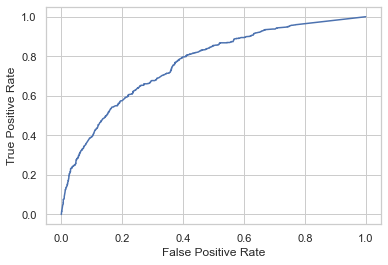

In [124]:
from sklearn import metrics
try:
    y_pred_proba =rfc1.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')

# Model 3

# RFC With Grid Search CV

In [125]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostClassifier
import matplotlib.pyplot as plt
rfc2=el()
params = {
 'n_estimators': [50, 100],
 'max_features':['auto', 'sqrt', 'log2'],
 'criterion' : ['entropy', 'gini'],
 'bootstrap': [True, False],
 'oob_score':[True, False],
 'n_jobs':[None,-1],
 'warm_start':[True, False]
}
gridsearch=GridSearchCV(rfc2, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
best_parameters=gridsearch.best_params_
best_score=gridsearch.best_score_
best_estim=gridsearch.best_estimator_
best_estim.fit(x_train,y_train)
y_pred2=best_estim.predict(x_train)
model3_train_score=best_estim.score(x_train, y_train)
model3_test_score=best_estim.score(x_test, y_test)
ytst_pred2=best_estim.predict(x_test)
model3_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred2})
model3_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred2})

In [127]:
# Model 3 Predictions

In [128]:
model3_prediction_train

,y_train,yhat
220,0.0,0.0
3465,1.0,1.0
4976,0.0,0.0
6754,1.0,0.0
4627,0.0,0.0
...,...,...
3176,1.0,0.0
6761,1.0,0.0
3246,1.0,1.0
4843,1.0,1.0


In [129]:
# Model 3 Metrics

In [130]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(best_estim.score(x_train, y_train),2))
print('Test Score: ', np.round(best_estim.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred2),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred2),2))

Train Score:  0.86
Test Score:  0.76
Train Accuracy Score:  0.86
Test Accuracy Score:  0.76


In [131]:
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'bootstrap': True, 'criterion': 'entropy', 'max_features': 'sqrt', 'n_estimators': 100, 'n_jobs': -1, 'oob_score': True, 'warm_start': True}
0.7646264429781054


In [132]:
best_estim=gridsearch.best_estimator_
print(best_estim)

RandomForestClassifier(criterion='entropy', max_features='sqrt', n_jobs=-1,
                       oob_score=True, warm_start=True)


In [133]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred2))

print(confusion_matrix(y_test, ytst_pred2))

              precision    recall  f1-score   support

         0.0       0.81      0.89      0.85      1853
         1.0       0.58      0.42      0.48       675

    accuracy                           0.76      2528
   macro avg       0.69      0.65      0.67      2528
weighted avg       0.75      0.76      0.75      2528

[[1646  207]
 [ 393  282]]


In [134]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred2), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.65


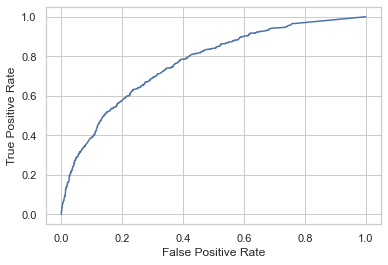

In [135]:
from sklearn import metrics
try:
    y_pred_proba =best_estim.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')    

# Model 4

# Bagging Classifier With Grid Search CV Hyper Parameter Tuning

In [136]:
import sklearn
abreg1 = sklearn.ensemble.BaggingClassifier()
params = {
 'n_estimators': [50, 100],
 'bootstrap': [True, False],
 'random_state': [0,10,100,1000,10000,100000,100000],
 'oob_score': [True, False]
 }
gridsearch1=GridSearchCV(abreg1, params, cv=5, return_train_score=True)
gridsearch1.fit(x_train, y_train)
best_parameters1=gridsearch1.best_params_
best_score1=gridsearch1.best_score_
best_estim1=gridsearch1.best_estimator_
best_estim1.fit(x_train,y_train)
y_pred3=best_estim1.predict(x_train)
model4_train_score=best_estim1.score(x_train, y_train)
model4_test_score=best_estim1.score(x_test, y_test)
ytst_pred3=best_estim1.predict(x_test)
model4_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred3})
model4_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred3})

In [137]:
# Model 4 Predictions

In [138]:
model4_prediction_train

,y_train,yhat
220,0.0,0.0
3465,1.0,1.0
4976,0.0,0.0
6754,1.0,0.0
4627,0.0,0.0
...,...,...
3176,1.0,0.0
6761,1.0,0.0
3246,1.0,1.0
4843,1.0,1.0


In [139]:
# Model 4 Metrics

In [140]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(best_estim1.score(x_train, y_train),2))
print('Test Score: ', np.round(best_estim1.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred3),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred3),2))

Train Score:  0.86
Test Score:  0.77
Train Accuracy Score:  0.86
Test Accuracy Score:  0.77


In [141]:
print(gridsearch1.best_params_)
print(gridsearch1.best_score_)

{'bootstrap': True, 'n_estimators': 100, 'oob_score': True, 'random_state': 10000}
0.7614052414427624


In [142]:
best_estim=gridsearch1.best_estimator_
print(best_estim)

BaggingClassifier(n_estimators=100, oob_score=True, random_state=10000)


In [143]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred3))

              precision    recall  f1-score   support

         0.0       0.81      0.89      0.85      1853
         1.0       0.59      0.43      0.50       675

    accuracy                           0.77      2528
   macro avg       0.70      0.66      0.67      2528
weighted avg       0.75      0.77      0.76      2528



In [144]:
print(confusion_matrix(y_test, ytst_pred3))

[[1652  201]
 [ 385  290]]


In [146]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred3), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.66


In [147]:
best_estim1=sklearn.ensemble.BaggingClassifier()
from sklearn import metrics
try:
    y_pred_proba =best_estim1.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')    

Multi Class Format Is Not Supported For ROC Curve


# Model5


# Support Vector Classifier with sigmoid


In [148]:
from sklearn import svm
clf = svm.SVC(kernel='sigmoid')
model5_prediction=clf.fit(x_train, y_train)
cross_scores=clf.score(x_train, y_train)
cross_risk=clf.score(x_test, y_test)

In [149]:
# Model 5 Predictions

In [150]:
y_pred5=pd.DataFrame(clf.predict(x_train), columns=['yhat'])
print('Train Prediction\n')
y_pred5

Train Prediction



,yhat
0,1.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
5892,0.0
5893,0.0
5894,0.0
5895,0.0


In [151]:
ytst_pred5=pd.DataFrame(clf.predict(x_test), columns=['yhat'])
print('Test Prediction\n')
ytst_pred5

Test Prediction



,yhat
0,0.0
1,1.0
2,1.0
3,0.0
4,0.0
...,...
2523,0.0
2524,0.0
2525,0.0
2526,0.0


In [152]:
# Model 5 Metrics

In [153]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(clf.score(x_train, y_train),2))
print('Test Score: ', np.round(clf.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred5),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred5),2))
print('Cross Validation Score: ', np.round(cv_scores,2))
print('Cross Validation Risk: ', np.round(cv_risk,2))

Train Score:  0.56
Test Score:  0.55
Train Accuracy Score:  0.56
Test Accuracy Score:  0.55
Cross Validation Score:  0.74
Cross Validation Risk:  0.0


In [154]:
print(confusion_matrix(y_test, ytst_pred5))

[[1300  553]
 [ 580   95]]


In [155]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred5), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.42


In [156]:
from sklearn import metrics
try:
    y_pred_proba =clf.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except AttributeError:
    print('Graph cannot be generated because probability is off for model development.')

Graph cannot be generated because probability is off for model development.


# Resampling, Rescaling And Re Feature Selection And Re Spliting For Model Optimization

# Reasoning Of Applying Resampling and developing models 6 to 10.


# The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve generalizability / robustness over a single estimator.
Two families of ensemble methods are usually distinguished:

In averaging methods, the driving principle is to build several estimators independently and then to average their predictions. On average, the combined estimator is usually better than any of the single base estimator because its variance is reduced.

Examples: Bagging methods, Forests of randomized trees, etcetera

By contrast, in boosting methods, base estimators are built sequentially and one tries to reduce the bias of the combined estimator. The motivation is to combine several weak models to produce a powerful ensemble.

Examples: AdaBoost, Gradient Tree Boosting,etcetera

# Since, original y vector is highly unsampled, I will do resampling to balance all 54 data points to ensure that alongwith being low on variance, the model is also low on bias. Hence, I can achieve, bias variance trade off.

# Hence, I have developed models 6 to 10 based on rfc, ensemble and svm methods on resampled data

In [157]:
y.value_counts() #original y vector, value counts

0.0    6259
1.0    2166
Name: RainTomorrow_encoded, dtype: int64

0.0    5646
1.0    5646
Name: RainTomorrow_encoded, dtype: int64


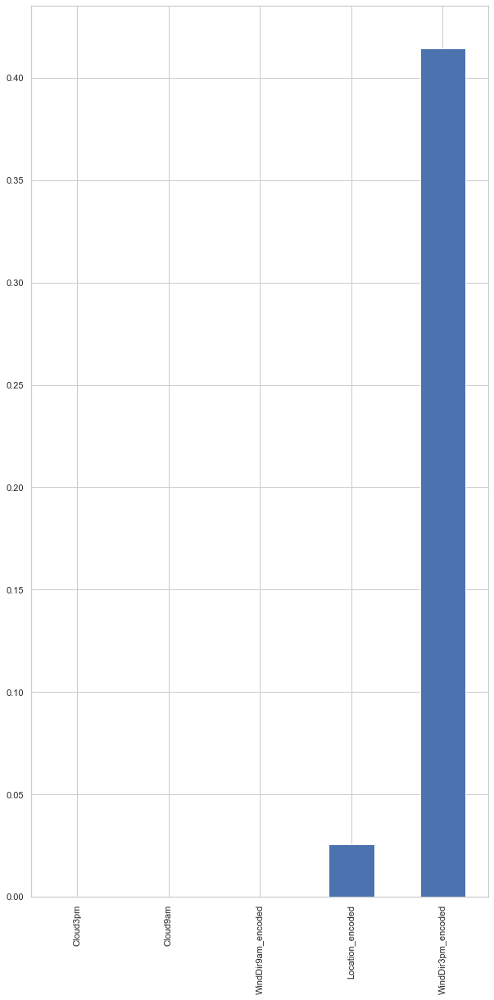

In [159]:
import numpy as np
from sklearn.utils import resample
x=x_frame11.copy()
y=final_dataframe['RainTomorrow_encoded']
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.1)
X=pd.concat([x_train, y_train], axis=1)
good=X[X['RainTomorrow_encoded']==0]
not_good=X[X['RainTomorrow_encoded']==1]
not_good_upsampled=resample(not_good, replace=True, n_samples=len(good), random_state=0)
upsampled=pd.concat([good, not_good_upsampled])
x=upsampled.drop('RainTomorrow_encoded', axis=1)
y=upsampled['RainTomorrow_encoded']
Xf_train, Xf_test, Y_train, Y_test=train_test_split(x,y,test_size=0.1)
print(upsampled['RainTomorrow_encoded'].value_counts())
constant_filter=VarianceThreshold(threshold=0.01)
constant_filter.fit(Xf_train)
Xf_train_filter=constant_filter.transform(Xf_train)
Xf_test_filter=constant_filter.transform(Xf_test)
sel=f_classif(Xf_train, Y_train)
p_values=pd.Series(sel[1])
p_values.index=Xf_train.columns
p_values.sort_values(ascending=True, inplace=True)
p_values.plot.bar(figsize=(10,20))
p_values=p_values[p_values<0.05]
p_values=pd.DataFrame(p_values, columns=['P Values'])
p_values['Features']=p_values.index
p_values=p_values[['Features', 'P Values']]
x=x[p_values['Features']]
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.1)

# The above matrix represent rebalanced label vector with count of each possibility enlisted with possibility code. And the graph shows new set of strong indicators based on p values, with variance threshold as low as 0.01 and confidence as 95%.

In [161]:
p_values

,Features,P Values
Cloud3pm,Cloud3pm,2.105606e-302
Cloud9am,Cloud9am,2.989064e-198
WindDir9am_encoded,WindDir9am_encoded,2.858387e-08
Location_encoded,Location_encoded,2.558253e-02


# Model 6

# RFC On Resampled Data With Intuitional Hyper Parameter Tuning

In [162]:
from sklearn.ensemble import RandomForestClassifier as el
from sklearn.model_selection import cross_val_score
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
import matplotlib.pyplot as plt
import pickle
rfc=el(200, criterion='entropy', random_state=100, max_features='sqrt', min_weight_fraction_leaf=0.1, min_impurity_decrease=0.01, n_jobs=-1, warm_start=True, max_depth=30, max_leaf_nodes=10, ccp_alpha=1, oob_score=True, bootstrap=True)
rfc.fit(x_train, y_train)
model1_train_score=rfc.score(x_train, y_train)
model1_test_score=rfc.score(x_test, y_test)
scores=cross_val_score(rfc, x, y, cv=5)
cv_scores=scores.mean()
cv_risk=scores.std()
y_pred=rfc.predict(x_train)
ytst_pred=rfc.predict(x_test)
model1_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred})
model1_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred})

In [163]:
# Model 6 Predictions

In [164]:
model1_prediction_train

,y_train,yhat
1921,0.0,0.0
445,0.0,0.0
3400,0.0,0.0
1275,1.0,0.0
2439,1.0,0.0
...,...,...
3950,0.0,0.0
2538,1.0,0.0
3435,0.0,0.0
1239,1.0,0.0


In [165]:
# Model 6 Metrics

In [166]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(rfc.score(x_train, y_train),2))
print('Test Score: ', np.round(rfc.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred),2))
print('Cross Validation Score: ', np.round(cv_scores,2))
print('Cross Validation Risk: ', np.round(cv_risk,2))

Train Score:  0.5
Test Score:  0.47
Train Accuracy Score:  0.5
Test Accuracy Score:  0.47
Cross Validation Score:  0.5
Cross Validation Risk:  0.0


In [167]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred))
print(confusion_matrix(y_test, ytst_pred))

              precision    recall  f1-score   support

         0.0       0.47      1.00      0.64       536
         1.0       0.00      0.00      0.00       594

    accuracy                           0.47      1130
   macro avg       0.24      0.50      0.32      1130
weighted avg       0.22      0.47      0.31      1130

[[536   0]
 [594   0]]


In [168]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.5


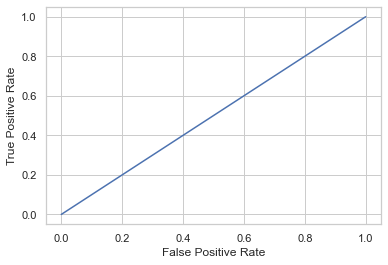

In [169]:
from sklearn import metrics
y_pred_proba =rfc.predict_proba(x_test)[::,1]
try:
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')    

# Model 7

# Support Vector Classifier with sigmoid to prevent overfitting on resampled data

In [179]:
from sklearn import svm
clf = svm.SVC(kernel='sigmoid')
model5_prediction=clf.fit(x_train, y_train)
cross_scores=clf.score(x_train, y_train)
cross_risk=clf.score(x_test, y_test)

In [180]:
# Model 8 Predictions

In [181]:
y_pred5=clf.predict(x_train)
y_pred5

array([0., 0., 1., ..., 1., 0., 1.])

In [182]:
ytst_pred5=clf.predict(x_test)
ytst_pred5

array([0., 1., 1., ..., 0., 0., 0.])

In [183]:
# Model 8 Metrics

In [184]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(clf.score(x_train, y_train),2))
print('Test Score: ', np.round(clf.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train,y_pred5),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test,ytst_pred5),2))
print('Cross Validation Score: ', np.round(cv_scores,2))
print('Cross Validation Risk: ', np.round(cv_risk,2))

Train Score:  0.59
Test Score:  0.59
Train Accuracy Score:  0.59
Test Accuracy Score:  0.59
Cross Validation Score:  0.5
Cross Validation Risk:  0.0


In [185]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test,ytst_pred5))
print(confusion_matrix(y_test,ytst_pred5))

              precision    recall  f1-score   support

         0.0       0.57      0.61      0.59       536
         1.0       0.62      0.58      0.60       594

    accuracy                           0.59      1130
   macro avg       0.59      0.59      0.59      1130
weighted avg       0.60      0.59      0.59      1130

[[329 207]
 [252 342]]


In [186]:
from sklearn import metrics
try:
    y_pred_proba =clf.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except AttributeError:
    print('Graph cannot be generated because probability is turned off for model development.')

Graph cannot be generated because probability is turned off for model development.


# Model 8

# RFC With Grid Search CV On Resampled Data

In [187]:
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostClassifier
import matplotlib.pyplot as plt
rfc2=el()
params = {
 'n_estimators': [50, 100],
 'max_features':['auto', 'sqrt', 'log2'],
 'criterion' : ['entropy', 'gini'],
 'bootstrap': [True, False],
 'oob_score':[True, False],
 'n_jobs':[None,-1],
 'warm_start':[True, False]
}
gridsearch=GridSearchCV(rfc2, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
best_parameters=gridsearch.best_params_
best_score=gridsearch.best_score_
best_estim=gridsearch.best_estimator_
best_estim.fit(x_train,y_train)
y_pred2=best_estim.predict(x_train)
model3_train_score=best_estim.score(x_train, y_train)
model3_test_score=best_estim.score(x_test, y_test)
ytst_pred2=best_estim.predict(x_test)
model3_save=pickle.dumps(best_estim) #saving the best model
model3_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred2})
model3_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred2})

In [299]:
# Train Prediction

In [188]:
model3_prediction_train

,y_train,yhat
1921,0.0,0.0
445,0.0,0.0
3400,0.0,0.0
1275,1.0,1.0
2439,1.0,1.0
...,...,...
3950,0.0,0.0
2538,1.0,1.0
3435,0.0,0.0
1239,1.0,1.0


In [189]:
# Test Prediction

In [190]:
model3_prediction_test

,y_test,yhat
5979,0.0,1.0
8132,1.0,1.0
6127,1.0,1.0
6587,0.0,0.0
3882,0.0,0.0
...,...,...
2240,0.0,0.0
7777,0.0,0.0
4737,1.0,0.0
829,1.0,1.0


In [191]:
# Metrics

In [192]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(best_estim.score(x_train, y_train),2))
print('Test Score: ', np.round(best_estim.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred2),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred2),2))

Train Score:  0.85
Test Score:  0.79
Train Accuracy Score:  0.85
Test Accuracy Score:  0.79


In [193]:
best_parameters, best_score, best_estim

({'bootstrap': True,
  'criterion': 'gini',
  'max_features': 'sqrt',
  'n_estimators': 50,
  'n_jobs': None,
  'oob_score': True,
  'warm_start': False},
 0.7949220731938758,
 RandomForestClassifier(max_features='sqrt', n_estimators=50, oob_score=True))

In [194]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred2))

print(confusion_matrix(y_test, ytst_pred2))

              precision    recall  f1-score   support

         0.0       0.85      0.69      0.76       536
         1.0       0.76      0.89      0.82       594

    accuracy                           0.79      1130
   macro avg       0.81      0.79      0.79      1130
weighted avg       0.80      0.79      0.79      1130

[[369 167]
 [ 65 529]]


In [195]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred2), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.79


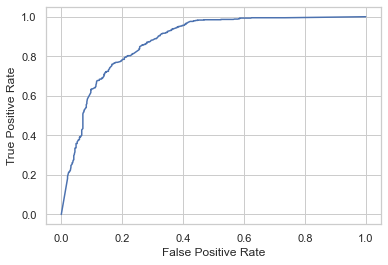

In [196]:
from sklearn import metrics
try:
    y_pred_proba =best_estim.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')    

# Model 9

# Bagging Classifier With Grid Search CV On Resampled Data

In [198]:
import sklearn
abreg1 = sklearn.ensemble.BaggingClassifier()
params = {
 'n_estimators': [50, 100],
 'bootstrap': [True, False],
 'random_state': [0,10,100,1000,10000,100000,100000],
 'oob_score': [True, False]
 }
gridsearch1=GridSearchCV(abreg1, params, cv=5, return_train_score=True)
gridsearch1.fit(x_train, y_train)
best_parameters1=gridsearch1.best_params_
best_score1=gridsearch1.best_score_
best_estim1=gridsearch1.best_estimator_
best_estim1.fit(x_train,y_train)
y_pred3=best_estim1.predict(x_train)
model4_train_score=best_estim1.score(x_train, y_train)
model4_test_score=best_estim1.score(x_test, y_test)
ytst_pred3=best_estim1.predict(x_test)
model4_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred3})
model4_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred3})

In [197]:
best_model1=pickle.dumps(best_estim1) #saving the best model

In [199]:
# Train Prediction

In [200]:
model4_prediction_train

,y_train,yhat
1921,0.0,0.0
445,0.0,0.0
3400,0.0,0.0
1275,1.0,1.0
2439,1.0,1.0
...,...,...
3950,0.0,0.0
2538,1.0,1.0
3435,0.0,0.0
1239,1.0,1.0


In [201]:
# Test Prediction

In [202]:
model4_prediction_test

,y_test,yhat
5979,0.0,1.0
8132,1.0,1.0
6127,1.0,1.0
6587,0.0,0.0
3882,0.0,0.0
...,...,...
2240,0.0,0.0
7777,0.0,0.0
4737,1.0,0.0
829,1.0,1.0


In [203]:
best_parameters1, best_score1, best_estim1

({'bootstrap': True,
  'n_estimators': 100,
  'oob_score': True,
  'random_state': 10000},
 0.7921667970610904,
 BaggingClassifier(n_estimators=100, oob_score=True, random_state=10000))

In [204]:
from sklearn.metrics import accuracy_score
print('Train Score: ', np.round(best_estim1.score(x_train, y_train),2))
print('Test Score: ', np.round(best_estim1.score(x_test, y_test),2))
print('Train Accuracy Score: ', np.round(accuracy_score(y_train, y_pred3),2))
print('Test Accuracy Score: ', np.round(accuracy_score(y_test, ytst_pred3),2))

Train Score:  0.85
Test Score:  0.8
Train Accuracy Score:  0.85
Test Accuracy Score:  0.8


In [205]:
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test, ytst_pred3))

              precision    recall  f1-score   support

         0.0       0.86      0.69      0.77       536
         1.0       0.76      0.90      0.83       594

    accuracy                           0.80      1130
   macro avg       0.81      0.80      0.80      1130
weighted avg       0.81      0.80      0.80      1130



In [206]:
print(confusion_matrix(y_test, ytst_pred3))

[[371 165]
 [ 60 534]]


In [207]:
from sklearn .metrics import roc_auc_score
try:
    auc = np.round(roc_auc_score(y_test, ytst_pred3), 2)
    print('auc: ',auc)
except ValueError:
    print('Data Is Imbalanced, ROC AUC Curve Cannot Be Generated.')

auc:  0.8


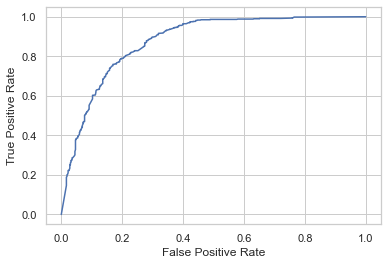

In [208]:
from sklearn import metrics
try:
    y_pred_proba =best_estim1.predict_proba(x_test)[::,1]
    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)

    #create ROC curve
    plt.plot(fpr,tpr)
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
except ValueError:
    print('Multi Class Format Is Not Supported For ROC Curve')    

# Best Models is saved in pickle for production

# Conclusion
Best model is:

Model 9: Bagging Classifier With Grid Search CV On Resampled Data

Train Score:  0.85

Test Score:  0.8

Train Accuracy Score:  0.85

Test Accuracy Score:  0.8

              precision    recall  f1-score   support

         0.0       0.86      0.69      0.77       536

         1.0       0.76      0.90      0.83       594

    accuracy                           0.80      1130
   
   macro avg       0.81      0.80      0.80      1130

weighted avg       0.81      0.80      0.80      1130

[[371 165]

[ 60 534]]

auc:  0.8

# Please note, metrics calculation is explained above while development and evaluation.

# Credits:
DataTrained and Python Documentations.

# Evaluation Project: Subpart 2

# Rainfall Prediction - Weather Forecasting Regression Predictive Analysis, Model Development, Model Evaluation and Model Selection Project

# Rainfall Prediction - Weather Forecasting is a regression based problem statement to classify rainfall tomorrow in yes and no responses from several indicators. The Dataset contains about 10 years of daily weather observations of different locations in Australia.

# Importing Data From Github repository dsrscientist/dataset3/main/weatherAUS.csv

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
warnings.filterwarnings('ignore')
data=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv')
data1=data.copy()  # creating a copy of dataframe
data

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [78]:
# Observation 1
shape_of_data=data.shape
print('Number Of Rows: ',shape_of_data[0], 'Number Of Columns: ', shape_of_data[1])

Number Of Rows:  8425 Number Of Columns:  23


# Data Cleaning

In [79]:
data.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [80]:
print('Type of storage of data ', type(data), '\nType of data series ', type(data.columns))

Type of storage of data  <class 'pandas.core.frame.DataFrame'> 
Type of data series  <class 'pandas.core.indexes.base.Index'>


In [81]:
data.isna().any()

Date             False
Location         False
MinTemp           True
MaxTemp           True
Rainfall          True
Evaporation       True
Sunshine          True
WindGustDir       True
WindGustSpeed     True
WindDir9am        True
WindDir3pm        True
WindSpeed9am      True
WindSpeed3pm      True
Humidity9am       True
Humidity3pm       True
Pressure9am       True
Pressure3pm       True
Cloud9am          True
Cloud3pm          True
Temp9am           True
Temp3pm           True
RainToday         True
RainTomorrow      True
dtype: bool

In [82]:
data.isna().values.any()

True

In [83]:
data.isnull().values.sum()

19472

In [84]:
data_1=data.select_dtypes(object).fillna('None')
data_2=data.select_dtypes(np.number).fillna(method='backfill')
data_2=data_2.fillna(0)
del data
data=pd.concat([data_1, data_2], axis=1)
data.isna().values.any()

False

In [85]:
data.dtypes, len(data.dtypes)

(Date              object
 Location          object
 WindGustDir       object
 WindDir9am        object
 WindDir3pm        object
 RainToday         object
 RainTomorrow      object
 MinTemp          float64
 MaxTemp          float64
 Rainfall         float64
 Evaporation      float64
 Sunshine         float64
 WindGustSpeed    float64
 WindSpeed9am     float64
 WindSpeed3pm     float64
 Humidity9am      float64
 Humidity3pm      float64
 Pressure9am      float64
 Pressure3pm      float64
 Cloud9am         float64
 Cloud3pm         float64
 Temp9am          float64
 Temp3pm          float64
 dtype: object,
 23)

In [86]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   WindGustDir    8425 non-null   object 
 3   WindDir9am     8425 non-null   object 
 4   WindDir3pm     8425 non-null   object 
 5   RainToday      8425 non-null   object 
 6   RainTomorrow   8425 non-null   object 
 7   MinTemp        8425 non-null   float64
 8   MaxTemp        8425 non-null   float64
 9   Rainfall       8425 non-null   float64
 10  Evaporation    8425 non-null   float64
 11  Sunshine       8425 non-null   float64
 12  WindGustSpeed  8425 non-null   float64
 13  WindSpeed9am   8425 non-null   float64
 14  WindSpeed3pm   8425 non-null   float64
 15  Humidity9am    8425 non-null   float64
 16  Humidity3pm    8425 non-null   float64
 17  Pressure9am    8425 non-null   float64
 18  Pressure

In [87]:
data.isnull().values.sum()

0

In [88]:
data.dtypes, len(data.dtypes)

(Date              object
 Location          object
 WindGustDir       object
 WindDir9am        object
 WindDir3pm        object
 RainToday         object
 RainTomorrow      object
 MinTemp          float64
 MaxTemp          float64
 Rainfall         float64
 Evaporation      float64
 Sunshine         float64
 WindGustSpeed    float64
 WindSpeed9am     float64
 WindSpeed3pm     float64
 Humidity9am      float64
 Humidity3pm      float64
 Pressure9am      float64
 Pressure3pm      float64
 Cloud9am         float64
 Cloud3pm         float64
 Temp9am          float64
 Temp3pm          float64
 dtype: object,
 23)

# Tabulated Conclusion Of Data Cleaning

In [89]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   WindGustDir    8425 non-null   object 
 3   WindDir9am     8425 non-null   object 
 4   WindDir3pm     8425 non-null   object 
 5   RainToday      8425 non-null   object 
 6   RainTomorrow   8425 non-null   object 
 7   MinTemp        8425 non-null   float64
 8   MaxTemp        8425 non-null   float64
 9   Rainfall       8425 non-null   float64
 10  Evaporation    8425 non-null   float64
 11  Sunshine       8425 non-null   float64
 12  WindGustSpeed  8425 non-null   float64
 13  WindSpeed9am   8425 non-null   float64
 14  WindSpeed3pm   8425 non-null   float64
 15  Humidity9am    8425 non-null   float64
 16  Humidity3pm    8425 non-null   float64
 17  Pressure9am    8425 non-null   float64
 18  Pressure

In [90]:
data1=data.copy()

# Verbal Translation Of Conclusion Of Above Data Cleaning Process

# Conclusion:
1. The dataset had 19472 missing values, that I have filled with default values and backfill methods, where applicable. The dataset does not have missing values now.
2. The whole dataset is of 8425 rows *23 columns shape, hence, chances of overerfitting, that is, model getting trained more than essential are high so we will go through the data thoroughly and try to draw anomalies and code some derived features, that can be of help in making predictions.
3. There are 16 continuous columns and 7 categorical columns, hence, encoding is required.

# Dataset Visualization 

# Head View

In [91]:
data.head()

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,MinTemp,MaxTemp,Rainfall,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,2008-12-01,Albury,W,W,WNW,No,No,13.4,22.9,0.6,...,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,2.0,16.9,21.8
1,2008-12-02,Albury,WNW,NNW,WSW,No,No,7.4,25.1,0.0,...,4.0,22.0,44.0,25.0,1010.6,1007.8,7.0,2.0,17.2,24.3
2,2008-12-03,Albury,WSW,W,WSW,No,No,12.9,25.7,0.0,...,19.0,26.0,38.0,30.0,1007.6,1008.7,7.0,2.0,21.0,23.2
3,2008-12-04,Albury,NE,SE,E,No,No,9.2,28.0,0.0,...,11.0,9.0,45.0,16.0,1017.6,1012.8,7.0,8.0,18.1,26.5
4,2008-12-05,Albury,W,ENE,NW,No,No,17.5,32.3,1.0,...,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7


# The above table represents first five rows of original dataset


# Sample View


In [92]:
data.sample()

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,MinTemp,MaxTemp,Rainfall,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
7787,2013-06-29,PerthAirport,N,NNE,N,No,No,6.7,22.3,0.0,...,13.0,2.0,81.0,31.0,1032.8,1030.5,1.0,1.0,12.0,22.1


# The above table represents a random row as sample row from the dataset


# Tail View

In [93]:
data.tail()

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,MinTemp,MaxTemp,Rainfall,...,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
8420,2017-06-21,Uluru,E,SE,ENE,No,No,2.8,23.4,0.0,...,13.0,11.0,51.0,24.0,1024.6,1020.3,3.0,2.0,10.1,22.4
8421,2017-06-22,Uluru,NNW,SE,N,No,No,3.6,25.3,0.0,...,13.0,9.0,56.0,21.0,1023.5,1019.1,3.0,2.0,10.9,24.5
8422,2017-06-23,Uluru,N,SE,WNW,No,No,5.4,26.9,0.0,...,9.0,9.0,53.0,24.0,1021.0,1016.8,3.0,2.0,12.5,26.1
8423,2017-06-24,Uluru,SE,SSE,N,No,No,7.8,27.0,0.0,...,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0
8424,2017-06-25,Uluru,None,ESE,ESE,No,None,14.9,0.0,0.0,...,17.0,17.0,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9


# The above table represents last five rows of the dataframe.

# Feature Engineering

# Encoding

In [94]:
data1=data.copy()

In [95]:
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder()
# transform data
result = encoder.fit_transform(data1.select_dtypes(include = [object]))
encoded_data=pd.DataFrame(data=result, columns=data1.select_dtypes(include = [object]).columns+'_'+'encoded')
encoded_data

,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,4.0,1.0,14.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...
8420,2999.0,9.0,0.0,10.0,1.0,0.0,0.0
8421,3000.0,9.0,6.0,10.0,3.0,0.0,0.0
8422,3001.0,9.0,3.0,10.0,15.0,0.0,0.0
8423,3002.0,9.0,10.0,11.0,3.0,0.0,0.0


# Concatenating Original Data With Encoded Data

In [96]:
data=pd.concat([data1, encoded_data], axis=1, ignore_index=False)
data=data.fillna(0)
data=data.drop(data.select_dtypes(object).columns, axis=1)
data.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,14.0,1.0,7.0,0.0,0.0


# Saving a copy of dataframe as final_dataframe that will be used further and data will be kept as storage of encoded and raw data.

In [97]:
final_dataframe=data.copy()
final_dataframe

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,14.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2.8,23.4,0.0,0.0,0.0,31.0,13.0,11.0,51.0,24.0,...,2.0,10.1,22.4,2999.0,9.0,0.0,10.0,1.0,0.0,0.0
8421,3.6,25.3,0.0,0.0,0.0,22.0,13.0,9.0,56.0,21.0,...,2.0,10.9,24.5,3000.0,9.0,6.0,10.0,3.0,0.0,0.0
8422,5.4,26.9,0.0,0.0,0.0,37.0,9.0,9.0,53.0,24.0,...,2.0,12.5,26.1,3001.0,9.0,3.0,10.0,15.0,0.0,0.0
8423,7.8,27.0,0.0,0.0,0.0,28.0,13.0,7.0,51.0,24.0,...,2.0,15.1,26.0,3002.0,9.0,10.0,11.0,3.0,0.0,0.0


In [98]:
len(final_dataframe.columns.unique())

23

In [99]:
final_dataframe.isna().values.any()

False

In [100]:
final_dataframe=final_dataframe.fillna(0)
final_dataframe.isna().values.any()

False

# There are no null and missing values in final dataframe.

# EDA Part 1

In [237]:
final_dataframe[:10]

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,14.0,1.0,7.0,0.0,0.0
5,14.6,29.7,0.2,8.6,9.0,56.0,19.0,24.0,55.0,23.0,...,8.0,20.6,28.9,5.0,1.0,15.0,14.0,14.0,0.0,0.0
6,14.3,25.0,0.0,8.6,9.0,50.0,20.0,24.0,49.0,19.0,...,8.0,18.1,24.6,6.0,1.0,14.0,13.0,14.0,0.0,0.0
7,7.7,26.7,0.0,8.6,9.0,35.0,6.0,17.0,48.0,19.0,...,8.0,16.3,25.5,7.0,1.0,14.0,11.0,14.0,0.0,0.0
8,9.7,31.9,0.0,8.6,9.0,80.0,7.0,28.0,42.0,9.0,...,8.0,18.3,30.2,8.0,1.0,6.0,10.0,7.0,0.0,2.0
9,13.1,30.1,1.4,8.6,9.0,28.0,15.0,11.0,58.0,27.0,...,8.0,20.1,28.2,9.0,1.0,14.0,9.0,11.0,2.0,0.0


# The above table represents first 10 rows from final dataframe.

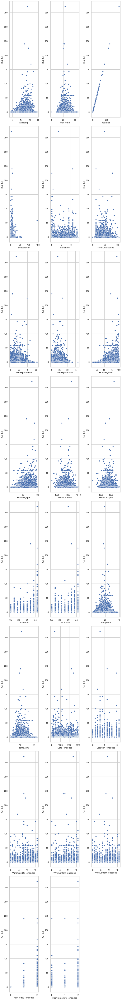

In [244]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.scatterplot(final_dataframe[colist[x]], y='Rainfall', data=final_dataframe)
        plt.tight_layout()
    except ValueError:
        continue

# It can be visualized from above scatter plots against outcome vector that
1. distribution is mostly unevenly distributed for most of the columns. For example,
    
    Temp 3 pm
    
    Rain Today Encoded
    
    Rain Tomorrow Encoded... and many more...


Anomalies:

1. Temp in the range 0 to 20 observes most amount of rainfall, as high as ~400 mm.

2. Lower evaporation observes higher rfainfall.

3. Lower sunshine observes higher rainfall except an outlier beyond 10.

4. Rainfall is observed at more quantum at less wind speed.

5. Rainfall is observed at more quantum at high humidity.

6. With more fraction of sky covered with cloud, rainfall is more.


Q&A Answered:

1. Range of Rainfall = 0 to 400

2. Range of cloud coverage: 0 to 7.5

3. Range of temperature at 9 am: 0 to 40

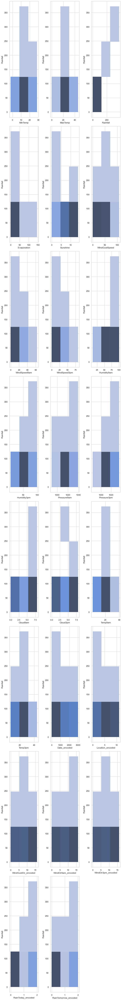

In [245]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.histplot(x=colist[x], y='Rainfall', data=final_dataframe, bins=3)
        plt.tight_layout()
    except ValueError:
        continue

# The above histograms show frequency distribution of features against label. It is divided into 3 bins. ['Pressure9am', 'Humidity9am', 'Cloud9am', 'Cloud3pm','WindDir3pm_encoded', 'Pressure3pm', 'MinTemp', 'WindGustDir_encoded','Location_encoded', 'Temp9am', 'WindDir9am_encoded', 'Humidity3pm', 'MaxTemp', 'Date_encoded', 'Temp3pm', 'WindSpeed3pm', 'WindGustSpeed'] seem to be close to normal with skewness threshold within +/-0.65. Normal distribution has 0 skewness. 

## 1. The entire dataframe against rainfall has skewness 11.10 and kurtosis 215.84, indicating high abnormalities with Rainfall as label. It reflects right skewed and leptokurtic data.

## 2. High skewness is observed in:

        Rainfall                11.105533

        Evaporation             10.302798


# Action Plan From Above Anomalies:

    1. Requires outliers removal and transformation to save adequately informative data for predictive development.

    2. Requires data scaling to normalize the existing columns and hence removing abnormally widespread data points.

# Q&A Answered:

## 1. Feature that can cause bias: Rainfall and Evaporation
## 2. Feature that can be used to explain label: ['Pressure9am', 'Humidity9am', 'Cloud9am', 'Cloud3pm','WindDir3pm_encoded', 'Pressure3pm', 'MinTemp', 'WindGustDir_encoded','Location_encoded', 'Temp9am', 'WindDir9am_encoded', 'Humidity3pm', 'MaxTemp', 'Date_encoded', 'Temp3pm', 'WindSpeed3pm', 'WindGustSpeed']

# Correlation Analysis

# Mathematical Notation:¶
Correlation (X, Y) = (Covariance Of X and Covariance Of Y)/(Std Of X and Std Of Y)

In [246]:
final_dataframe.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
MinTemp,1.000000,0.719058,0.104892,0.145762,0.015720,0.205851,0.137734,0.183564,-0.132351,0.082261,...,0.057409,0.888200,0.686459,0.015722,0.116543,-0.152430,-0.077730,-0.140749,0.072276,0.103287
MaxTemp,0.719058,1.000000,-0.059683,0.192643,0.284214,0.125441,0.011896,0.089741,-0.388256,-0.412668,...,-0.203864,0.867999,0.972195,0.102042,0.063463,-0.235584,-0.238606,-0.179090,-0.221041,-0.148565
Rainfall,0.104892,-0.059683,1.000000,0.261882,-0.125110,0.073946,0.048887,0.026858,0.209497,0.216646,...,0.125924,0.014773,-0.064982,0.050052,0.038412,0.058043,0.097316,0.033582,0.426020,0.232277
Evaporation,0.145762,0.192643,0.261882,1.000000,0.141211,0.079904,0.044235,0.073853,-0.080469,-0.084723,...,-0.027672,0.175737,0.188991,0.222972,0.148349,-0.007506,0.005012,-0.029649,-0.009015,0.002032
Sunshine,0.015720,0.284214,-0.125110,0.141211,1.000000,-0.144677,-0.139161,-0.065542,-0.227471,-0.331823,...,-0.473379,0.171215,0.302656,0.250422,0.104241,-0.046486,-0.048347,-0.030696,-0.200695,-0.282171
WindGustSpeed,0.205851,0.125441,0.073946,0.079904,-0.144677,1.000000,0.657965,0.654828,-0.294750,-0.122383,...,0.124077,0.182761,0.090173,-0.152167,0.196354,0.020742,-0.095281,0.051571,0.075493,0.170023
WindSpeed9am,0.137734,0.011896,0.048887,0.044235,-0.139161,0.657965,1.000000,0.562749,-0.358644,-0.112526,...,0.136086,0.108630,-0.003153,-0.086453,0.222325,-0.045049,-0.068171,0.035544,0.042830,0.074274
WindSpeed3pm,0.183564,0.089741,0.026858,0.073853,-0.065542,0.654828,0.562749,1.000000,-0.253077,-0.091454,...,0.085843,0.186996,0.064722,-0.053517,0.229900,0.046221,-0.032251,0.080531,0.027821,0.056963
Humidity9am,-0.132351,-0.388256,0.209497,-0.080469,-0.227471,-0.294750,-0.358644,-0.253077,1.000000,0.631196,...,0.248377,-0.377465,-0.380971,0.088439,0.006010,0.066148,0.095302,-0.015739,0.377661,0.278140
Humidity3pm,0.082261,-0.412668,0.216646,-0.084723,-0.331823,-0.122383,-0.112526,-0.091454,0.631196,1.000000,...,0.401880,-0.125526,-0.490290,-0.039559,0.056522,0.080130,0.149644,-0.010906,0.361094,0.450328


# The above table represents correlation among dataset. 
There seems some multicollinearity due to presence of 

Apart from this, there seems moderate multicollinearity among features:

    Max Temp and Min Temp
    
    Min Temp and Temp 9 am
    
    Min Temp and Temp 3 pm
    
    Max Temp and Temp 9 pm
    
    Max Temp and Temp 3 pm
    
    Humidity 3pm and Humidity 9 am

## Action Plan:
I will do further eda on Max Temp, Min Temp, Temp 9 am, Temp 3 pm, Humidity 3 pm and Humidity 9 am to gauge to weight biasness caused by it against its label explanation capacity.

# Correlation Heatmap Of Original Dataset

<AxesSubplot:>

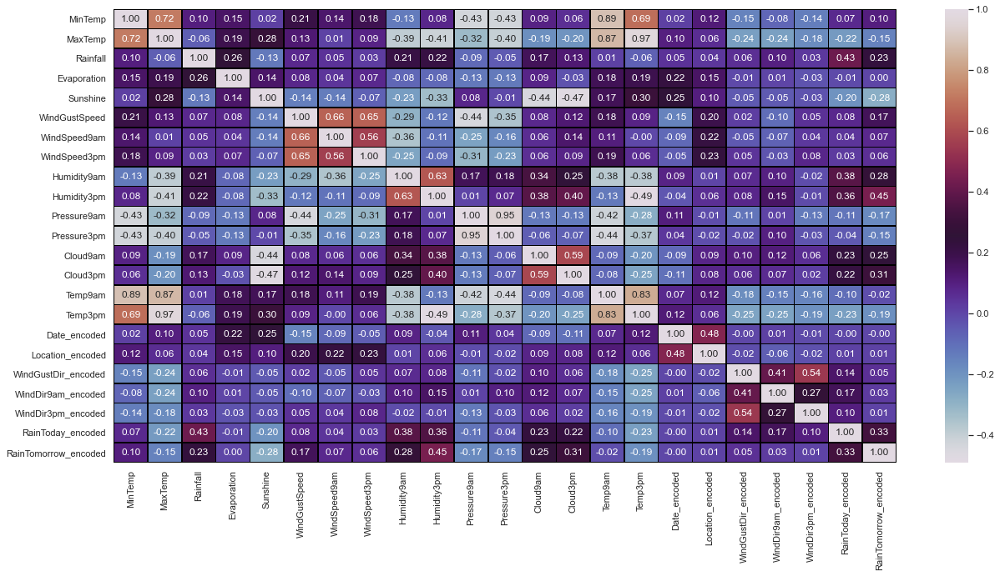

In [247]:
plt.figure(figsize=(21,10))
sns.heatmap(final_dataframe.corr(), annot=True, linewidths=0.5, linecolor='black', fmt='.2f', cmap='twilight')

# Verbal Translation Of Above Graph:
# 1. Label has weak negative relationship with these features:

        MaxTemp, 
        
        Sunshine, 
        
        Pressure9am, 
        
        Pressure3pm, 
        
        Temp3pm           

# 2. Label has weak positive to strong positive relationship with these features in this heatmap:

       Temp9am, 
       
       WindSpeed3pm, 
       
       WindDir3pm_encoded, 
       
       Location_encoded,
       
       WindSpeed9am, 
       
       Date_encoded, 
       
       WindGustDir_encoded, 
       
       WindGustSpeed,
       
       WindDir9am_encoded, 
       
       MinTemp, 
       
       Cloud3pm, 
       
       Cloud9am, 
       
       Humidity9am,
       
       Humidity3pm, 
       
       RainTomorrow_encoded, 
       
       Evaporation,
       
       RainToday_encoded

# 3. Strong Multicollinearity is detected between:

        Max Temp and Min Temp
        
        Min Temp and Temp 9 am
        
        Min Temp and Tem 3 pm
        
        Max Temp and Temp 9 pm
        
        Max Temp and Temp 3 pm
        
        Humidity 3pm and Humidity 9 am


# 4. Multicollinearity seems to be moderate among all other data points.

# Graphical Representation Of Correlation Of Features With Label

In [248]:
import cufflinks as cf
cf.set_config_file(offline=True)
pd.DataFrame(final_dataframe.corr()['Rainfall']).iplot(title='Correlation Of Variables With Label')

# The above iplot represents correlation of features with label. Correlation of features with label is of high relevance. The stronger the relationship of label with axis, the more accurate the prediction. In the above line graph:

# 1. Highest correlation with label is observed to be 42.60%, that is shared with Rain Today Encoded. Minimum correlation is 1.5%, that is shared with Temp9am.

# 2. Weak Negative Relationship Is Found With Following Features:

        Sunshine      -0.125110
        
        Pressure9am   -0.088185
        
        Temp3pm       -0.064982
        
        MaxTemp       -0.059683
        
        Pressure3pm   -0.051706


# 3. Weak Positive To Strong Positive Relationship Is Found With Following Features:

        Temp9am                 0.014773
        
        WindSpeed3pm            0.026858
        
        WindDir3pm_encoded      0.033582
        
        Location_encoded        0.038412
        
        WindSpeed9am            0.048887
        
        Date_encoded            0.050052
        
        WindGustDir_encoded     0.058043
        
        WindGustSpeed           0.073946
        
        WindDir9am_encoded      0.097316
        
        MinTemp                 0.104892
        
        Cloud3pm                0.125924
        
        Cloud9am                0.168974
        
        Humidity9am             0.209497
        
        Humidity3pm             0.216646
        
        RainTomorrow_encoded    0.232277
        
        Evaporation             0.261882
        
        RainToday_encoded       0.426020 

# 4. Correlation Of Label with itself is of no relevance

# Overall Conclsuion Of Correlation Analysis

# Overall correlation among dataset, There seems some multicollinearity due to presence of Max Temp and Min Temp; Min Temp and Temp 9 am; Min Temp and Temp 3 pm; Max Temp and Temp 9 pm; Max Temp and Temp 3 pm; Humidity 3pm and Humidity 9 am.We will do further eda before arriving at a conclusion to delete these columns.

# 1. The most useful feature is Rain Today Encoded, apart from this, there seems modest correlation of features with label.

# 2. As a conclusion, we will do further cause and effect analysis based on skewness and distribution plots to conclude if we want to remove multicollinarity causing column:

## i. Min Temp
## ii. Max Temp
## iii. Temp 9 am 
## iv Temp 3 pm
## v. Humidity 9 am
    
# 3. Highest Bias (Multicollinearity) is observed in:
## i. Min Temp
## ii. Max Temp
## iii. Temp 9 am 
## iv Temp 3 pm
## v. Humidity 9 am

# Q&A Answered
## 1. Most useful feature for prediction: Rain Today Encoded
## 2. Most bias causing feature:
    ## i. Min Temp
    ## ii. Max Temp
    ## iii. Temp 9 am 
    ## iv Temp 3 pm
    ## v. Humidity 9 am


# Dataset Information Table

In [249]:
final_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   MinTemp               8425 non-null   float64
 1   MaxTemp               8425 non-null   float64
 2   Rainfall              8425 non-null   float64
 3   Evaporation           8425 non-null   float64
 4   Sunshine              8425 non-null   float64
 5   WindGustSpeed         8425 non-null   float64
 6   WindSpeed9am          8425 non-null   float64
 7   WindSpeed3pm          8425 non-null   float64
 8   Humidity9am           8425 non-null   float64
 9   Humidity3pm           8425 non-null   float64
 10  Pressure9am           8425 non-null   float64
 11  Pressure3pm           8425 non-null   float64
 12  Cloud9am              8425 non-null   float64
 13  Cloud3pm              8425 non-null   float64
 14  Temp9am               8425 non-null   float64
 15  Temp3pm              

# The above table reprents information dataset:
    
    i. Columns

    ii. Count Of Non Null Data Points

    iii. Values data type for each columns

    iv. Count of data types in iii.

    v. Memory Usage

   # It can be deduced that the dataset has 8425 rows and each column has no missing values. 
The datatypes used are float64. There 23 float64 columns. Memory usage is 1.5 MB.

# Names of all the columns

In [250]:
final_dataframe.select_dtypes(include = [np.number]).columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded',
       'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded',
       'RainToday_encoded', 'RainTomorrow_encoded'],
      dtype='object')

# The above code cell highlights all numeric values, that will be used to derive following graphs.

# Box Plot To Detect Outliers

In [251]:
import plotly.express as px
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
for x in colist:
    try:
        plot = px.box(data_frame=final_dataframe,x=x, y='Rainfall')
        plot.show()
    except ValueError:
        print('{0} vales out of range, try skewness function to detect outliers'.format(x))
        continue

# Verbal Translation Of Above Graph
1. The data seems to be biased, as analyzed above, example, Min Temp, etcetera. Hence, we will go through descriptive stats for further analysis.

# Descriptive Statistics

In [252]:
description=final_dataframe.describe()
description

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,...,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193329,23.871181,3.322944,7.127632,8.833970,37.651869,13.811751,18.455193,67.859941,51.272047,...,4.282849,17.770255,22.450493,1296.570564,5.793591,8.298398,8.219941,8.316439,0.500890,0.501009
std,5.398520,6.145269,11.865187,10.655038,3.326096,16.168730,10.181388,9.814225,16.809144,18.405299,...,2.849813,5.621854,5.960242,854.249434,3.162654,4.857927,4.786534,4.847244,0.849993,0.850133
min,-2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,6.000000,...,0.000000,1.900000,7.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.200000,19.300000,0.000000,3.800000,8.000000,26.000000,6.000000,11.000000,56.000000,39.000000,...,1.000000,13.800000,18.100000,589.000000,3.000000,4.000000,4.000000,4.000000,0.000000,0.000000
50%,13.300000,23.300000,0.000000,6.400000,9.200000,37.000000,13.000000,19.000000,68.000000,51.000000,...,5.000000,17.800000,21.900000,1088.000000,6.000000,8.000000,8.000000,9.000000,0.000000,0.000000
75%,17.400000,28.100000,1.200000,8.000000,11.100000,48.000000,20.000000,24.000000,80.000000,63.000000,...,7.000000,22.000000,26.400000,2021.000000,8.000000,13.000000,13.000000,12.000000,1.000000,1.000000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,...,8.000000,39.400000,44.100000,3003.000000,11.000000,16.000000,16.000000,16.000000,2.000000,2.000000


In [253]:
lst=description.columns.to_list()
print(lst)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Date_encoded', 'Location_encoded', 'WindGustDir_encoded', 'WindDir9am_encoded', 'WindDir3pm_encoded', 'RainToday_encoded', 'RainTomorrow_encoded']


In [254]:
lst1=[]
for x in range(len(lst)):
    lst1.append([description.iloc[6,x]-description.iloc[5,x]])
len(lst1), print(lst1)

[[4.099999999999998], [4.800000000000001], [1.2], [1.5999999999999996], [1.9000000000000004], [11.0], [7.0], [5.0], [12.0], [12.0], [2.1000000000000227], [2.5], [2.0], [2.0], [4.199999999999999], [4.5], [933.0], [2.0], [5.0], [5.0], [3.0], [1.0], [1.0]]


(23, None)

In [255]:
lst1_frame=pd.DataFrame(data=lst1, index=lst, columns=['IQR'])
lst1_frame=lst1_frame.T
lst1_frame

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
IQR,4.1,4.8,1.2,1.6,1.9,11.0,7.0,5.0,12.0,12.0,...,2.0,4.2,4.5,933.0,2.0,5.0,5.0,3.0,1.0,1.0


In [256]:
lst3=[]
for x in range(len(lst)):
    lst3.append([description.iloc[7,x]-description.iloc[3,x]])


In [257]:
lst3_frame=pd.DataFrame(data=lst3, index=lst, columns=['Range'])
lst3_frame=lst3_frame.T
lst3_frame

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
Range,30.5,45.5,371.0,145.0,13.9,107.0,63.0,83.0,90.0,93.0,...,8.0,37.5,36.8,3003.0,11.0,16.0,16.0,16.0,2.0,2.0


In [258]:
lst5=pd.DataFrame(data=final_dataframe.skew().to_list(), index=lst, columns=['Skewness'])
lst5=lst5.T
lst6=pd.DataFrame(data=final_dataframe.kurtosis().to_list(), index=lst, columns=['Kurtosis'])
lst6=lst6.T
lst5, lst6

(           MinTemp   MaxTemp   Rainfall  Evaporation  Sunshine  WindGustSpeed  \
 Skewness -0.091183  0.369918  11.105533     10.27809 -1.215835       0.505139   
 
           WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  ...  Cloud3pm  \
 Skewness       0.95422      0.494839    -0.258077     0.124258  ... -0.099767   
 
            Temp9am   Temp3pm  Date_encoded  Location_encoded  \
 Skewness -0.018532  0.392189       0.38656         -0.050456   
 
           WindGustDir_encoded  WindDir9am_encoded  WindDir3pm_encoded  \
 Skewness            -0.132022           -0.016024           -0.110828   
 
           RainToday_encoded  RainTomorrow_encoded  
 Skewness           1.151504              1.151145  
 
 [1 rows x 23 columns],
            MinTemp   MaxTemp    Rainfall  Evaporation  Sunshine  \
 Kurtosis -0.580951 -0.250355  215.835585   125.596905   0.73713   
 
           WindGustSpeed  WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  \
 Kurtosis       0.134672      1.07

In [259]:
description1=pd.concat([description, lst1_frame, lst3_frame, lst5, lst6])
description1

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
count,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,...,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000,8425.000000
mean,13.193329,23.871181,3.322944,7.127632,8.833970,37.651869,13.811751,18.455193,67.859941,51.272047,...,4.282849,17.770255,22.450493,1296.570564,5.793591,8.298398,8.219941,8.316439,0.500890,0.501009
std,5.398520,6.145269,11.865187,10.655038,3.326096,16.168730,10.181388,9.814225,16.809144,18.405299,...,2.849813,5.621854,5.960242,854.249434,3.162654,4.857927,4.786534,4.847244,0.849993,0.850133
min,-2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,6.000000,...,0.000000,1.900000,7.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.200000,19.300000,0.000000,3.800000,8.000000,26.000000,6.000000,11.000000,56.000000,39.000000,...,1.000000,13.800000,18.100000,589.000000,3.000000,4.000000,4.000000,4.000000,0.000000,0.000000
50%,13.300000,23.300000,0.000000,6.400000,9.200000,37.000000,13.000000,19.000000,68.000000,51.000000,...,5.000000,17.800000,21.900000,1088.000000,6.000000,8.000000,8.000000,9.000000,0.000000,0.000000
75%,17.400000,28.100000,1.200000,8.000000,11.100000,48.000000,20.000000,24.000000,80.000000,63.000000,...,7.000000,22.000000,26.400000,2021.000000,8.000000,13.000000,13.000000,12.000000,1.000000,1.000000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,...,8.000000,39.400000,44.100000,3003.000000,11.000000,16.000000,16.000000,16.000000,2.000000,2.000000
IQR,4.100000,4.800000,1.200000,1.600000,1.900000,11.000000,7.000000,5.000000,12.000000,12.000000,...,2.000000,4.200000,4.500000,933.000000,2.000000,5.000000,5.000000,3.000000,1.000000,1.000000
Range,30.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,90.000000,93.000000,...,8.000000,37.500000,36.800000,3003.000000,11.000000,16.000000,16.000000,16.000000,2.000000,2.000000


In [260]:
# Graphical Representation Of Above Table

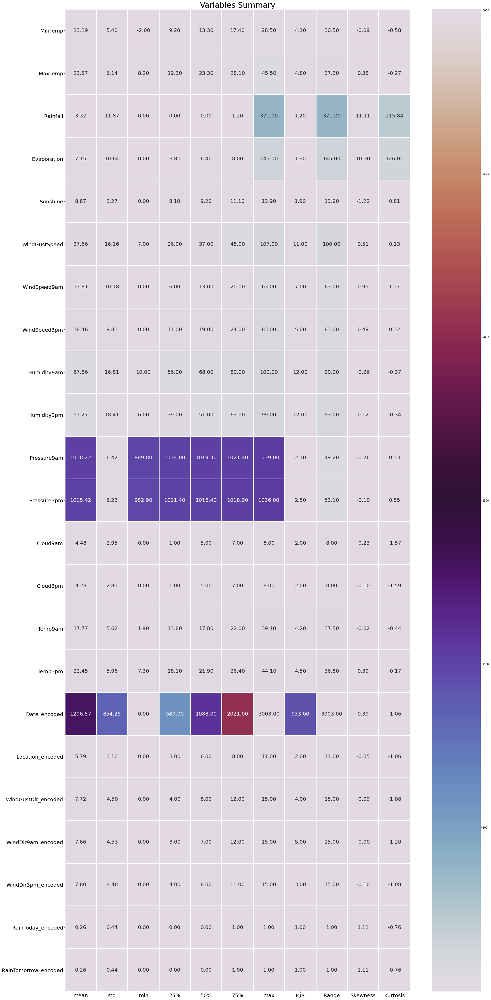

In [109]:
import numpy as np
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(30,70))
sns.heatmap(round(description1[1:].transpose(),2), linewidth=2, annot=True, fmt='.2f', square=False, cmap='twilight',annot_kws={'fontsize':20} )
plt.xticks(fontsize=20, color='black')
plt.yticks(fontsize=20, color='black', rotation=360)
plt.title('Variables Summary', fontsize=30, pad=3)
plt.show()

# Mathematical Notation:
1. Mean = sum of values/count of values                                                                                     
2. std = sqrt(((value - mean of distribution)**2 / number of values ))                                                                                        
3. 3 quartile are measures of variance, calculated to spot the placeholder value, it returns index of the produced value.
Step 1: sort the dataset                                                                                                   
Step2:                                                                                                                     
i) Lower Quartile (Q1: 25% distribution) = ((number of values+1)/4)th Term                                                 
ii) Middle Quartile (Q2: 50% distribution) = ((number of values +1)/2)th Term                                               
Also, know as median (central value).                                                                                       
iii) Upper Quartile (Q3: 75% distribution) = ¾(number of values + 1)th Term                                                 
iv) IQR = Upper Quartile - Lowe Quartile                                                                                   
4. Range = Maximum Value - Minimum Value                                                                                   
5. Skewness = (sumation(value - mean of distribution)**3)/((number of values - 1) * std**3)                                 
6. Kurtosis = number of values * ((sumation(value - mean of distribution)**4) / std**4)

# Verbal Translation Of Descriptive Table And Graphic

# Verbal Translation Of Descriptive Table And Graphic
1. For values that are scaled upto 1, mean is mostly around 0 and standard deviation is comparatively low. Hence, making the data much more acceptable by algorithms to process it more accurately.

2. The entire dataset ranges from -2 till 3003.0.

3. IQR, Range and Skewness and kurtosis are much more condensed in data that is scaled upto 1.


4. The entire dataframe against rainfall has skewness 11.10 and kurtosis 215.84, indicating high abnormalities with Rainfall as label. It reflects right skewed and leptokurtic data.

5. Skewness is 0 and within +/- 0.65 for:
        
        Humidity3pm              0.124258
        
        MaxTemp                  0.376325
        
        Date_encoded             0.386560
        
        Temp3pm                  0.392189
        
        WindSpeed3pm             0.494839
        
        WindGustSpeed            0.506454
        
        Pressure9am           -0.264378
        
        Humidity9am           -0.258077
        
        Cloud9am              -0.234198
        
        Cloud3pm              -0.099767
        
        WindDir3pm_encoded    -0.097025
        
        Pressure3pm           -0.096828
        
        MinTemp               -0.091183
        
        WindGustDir_encoded   -0.089944
        
        Location_encoded      -0.050456
        
        Temp9am               -0.018532
        
        WindDir9am_encoded    -0.001343
    
6. High skewness is observed in:
        
        RainTomorrow_encoded     1.111827
        
        RainToday_encoded        1.114674
        
        Evaporation             10.302798
        
        Rainfall                11.105533
        
        Sunshine              -1.223477

7. Acceptable skewness is +/- 0.65 and skewness for bell shaped curve should be 0.

8. Kutosis is upto 3 for most dataset, indicating platykurtic curves.

9. Kurtosis is greater than 3, indicating, leptokurtic curve for:

        Evaporation    126.006929
        
        Rainfall       215.835585

8. Kurtosis for bell shaped curve should be 3.

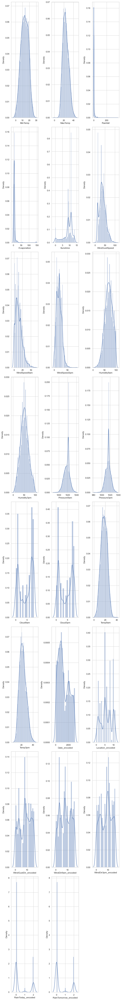

In [263]:
colist=final_dataframe.select_dtypes(include = [np.number]).columns
ncol=3
nrows=10
plt.figure(figsize=(ncol*3, ncol*30))
for x in range(0,len(colist)):
    try:
        sns.set_theme(style='whitegrid')
        plt.subplot(nrows, ncol, x+1)
        sns.distplot(final_dataframe[colist[x]])
        plt.tight_layout()
    except ValueError:
        continue

# Observations

# 1. Acceptable skewness is +/-0.65 and Correct skewness for bell shaped curve is 0


# 2. Acceptable And Outliers Prone Right Skewness is observed in:
         
         Humidity3pm              0.124258

         MaxTemp                  0.376325

         Date_encoded             0.386560

         Temp3pm                  0.392189

         WindSpeed3pm             0.494839

         WindGustSpeed            0.506454
         
          RainTomorrow_encoded     1.111827

         RainToday_encoded        1.114674

         Evaporation             10.302798

         Rainfall                11.105533
        
# 3. Acceptable And Outliers Prone Left Skewness is observed in:
        
         Pressure9am           -0.264378

         Humidity9am           -0.258077

         Cloud9am              -0.234198

         Cloud3pm              -0.099767

         WindDir3pm_encoded    -0.097025

         Pressure3pm           -0.096828

         MinTemp               -0.091183

         WindGustDir_encoded   -0.089944

         Location_encoded      -0.050456

         Temp9am               -0.018532

         WindDir9am_encoded    -0.001343

         Sunshine              -1.223477
        

# Conclusion:

# Based On EDA done above in two parts, I will do f test and ptest on these biased columns:

 1. Evaporation (Skewness and Kurtosis)

 2. Max Temp   (Kurtosis and Multicollinearity) 
 
 3. Temp 3 pm  (Kurtosis and Multicollinearity)

# Error Removal And Data Handling
# ANOVA Test On Selected Features
## Ftest score should be greater than 1 and p value should be less than 0.05, to determine to keep these features for further analysis

# Column 1: Evaporation

In [110]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['Evaporation'], final_dataframe['Rainfall'])
f,p

(479.5571565361984, 7.703480675515605e-105)

# Column 2: MaxTemp

In [111]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['MaxTemp'], final_dataframe['Rainfall'])
f,p

(19923.539631703658, 0.0)

# Column 3: Temp 3 PM

In [112]:
from scipy.stats import f_oneway
f,p=f_oneway(final_dataframe['Temp3pm'], final_dataframe['Rainfall'])
f,p

(17483.107027137972, 0.0)

Error Removal And Data Handling
Based on above analysis:
1. There are no outliers in the data.
2. Strong multicolliearity features are important for prediction because there f test and p value are acceptable. This means that the amount of multicollineaity is insignificant and removing the feature will lower explanatory capacity of the model.
3. Extereme leptokurtic and right skewed features are also relatively significant based on f test and p test.
4. Extreme platykurtic and left skewed features are also relatively significant based on f test and p test.


## Hence, as a solution, feature scaling will do a better job in explaining the dependent variable than removing whole columns.

## Prior to feature scaling, I will put the features through vif test and outliers transformation for better training of the model.

In [408]:
# Z Score: Outliers Treatment

In [113]:
import numpy as np
from scipy.stats import stats
from sklearn.preprocessing import StandardScaler
scaled = StandardScaler()
final_dataframe=final_dataframe.fillna(0)
scaled.fit(final_dataframe)
scaled_data = scaled.transform(final_dataframe)
score=np.abs(stats.zscore(scaled_data))
score.shape

(8425, 23)

In [114]:
#threshold=(-3,3)
threshold=3
print(np.where(score>3))

(array([  12,   12,   44,   44,   52,   52,   60,   60,   61,   61,   62,
         62,   67,   68,   68,  123,  296,  381,  381,  405,  406,  407,
        407,  431,  462,  563,  568,  683,  683,  699,  713,  748,  748,
        796,  797,  802,  928,  949,  979,  980,  980,  980, 1008, 1009,
       1011, 1138, 1148, 1149, 1151, 1189, 1237, 1241, 1264, 1265, 1357,
       1411, 1412, 1479, 1480, 1481, 1513, 1535, 1587, 1644, 1665, 1673,
       1680, 1774, 1898, 1903, 1945, 2016, 2028, 2042, 2043, 2074, 2116,
       2186, 2199, 2200, 2201, 2219, 2219, 2230, 2231, 2265, 2505, 2527,
       2527, 2541, 2593, 2676, 2677, 2735, 2859, 2890, 2898, 2900, 3003,
       3051, 3051, 3058, 3059, 3059, 3066, 3067, 3067, 3067, 3068, 3082,
       3082, 3082, 3089, 3089, 3099, 3099, 3141, 3153, 3167, 3172, 3173,
       3174, 3175, 3176, 3177, 3178, 3200, 3201, 3202, 3203, 3204, 3205,
       3206, 3212, 3212, 3230, 3230, 3231, 3231, 3232, 3232, 3233, 3233,
       3234, 3234, 3235, 3235, 3236, 3236, 3237, 3

# The above cell displays outlier values.

In [115]:
len(np.where(score>3)[0])

507

# The above cell shows number of outliers.

In [116]:
data_new=final_dataframe[(score<3).all(axis=1)]
data_new

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,14.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8419,3.5,21.8,0.0,0.0,0.0,31.0,15.0,13.0,59.0,27.0,...,2.0,9.4,20.9,2998.0,9.0,0.0,2.0,0.0,0.0,0.0
8420,2.8,23.4,0.0,0.0,0.0,31.0,13.0,11.0,51.0,24.0,...,2.0,10.1,22.4,2999.0,9.0,0.0,10.0,1.0,0.0,0.0
8421,3.6,25.3,0.0,0.0,0.0,22.0,13.0,9.0,56.0,21.0,...,2.0,10.9,24.5,3000.0,9.0,6.0,10.0,3.0,0.0,0.0
8422,5.4,26.9,0.0,0.0,0.0,37.0,9.0,9.0,53.0,24.0,...,2.0,12.5,26.1,3001.0,9.0,3.0,10.0,15.0,0.0,0.0


# The above table shows the final dataframe after removing outliers, 507 rows are removed and resultant dimension is 8040 rows * 23 columns

# IQR Method Of Outliers Removal

# Since, most of the rows are removed by z method, hence, I will try IQR Method of outliers removal and power transformation method of outliers transformation.

In [117]:
Q1= final_dataframe[final_dataframe.columns].quantile(0.25)
Q3 = final_dataframe[final_dataframe.columns].quantile(0.75)
IQR = Q3 - Q1
upper_limit = Q3 + 1.5 * IQR
lower_limit = Q1 - 1.5 * IQR

In [118]:
# The above code calculates IQR as discussed in descriptive statistics section of eda. It Upper Limit and Lower Limit of distribution curve.

In [119]:
final_dataframe[(final_dataframe[final_dataframe.columns] < lower_limit) | (final_dataframe[final_dataframe.columns] > upper_limit)] # outliers

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8421,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8422,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8423,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# The above table displays, outliers detected by IQR Method, it displays all values beyond upper and lower limit and places NaN on all the values that are significant and within upper and lower limits.

In [120]:
new_df = final_dataframe[(final_dataframe[final_dataframe.columns] > lower_limit) & (final_dataframe[final_dataframe.columns] < upper_limit)]

In [121]:
new_df=new_df.fillna(method='bfill')
new_df

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,13.4,22.9,0.6,8.6,9.0,44.0,20.0,24.0,71.0,22.0,...,2.0,16.9,21.8,0.0,1.0,14.0,14.0,15.0,0.0,0.0
1,7.4,25.1,0.0,8.6,9.0,44.0,4.0,22.0,44.0,25.0,...,2.0,17.2,24.3,1.0,1.0,15.0,6.0,16.0,0.0,0.0
2,12.9,25.7,0.0,8.6,9.0,46.0,19.0,26.0,38.0,30.0,...,2.0,21.0,23.2,2.0,1.0,16.0,14.0,16.0,0.0,0.0
3,9.2,28.0,0.0,8.6,9.0,24.0,11.0,9.0,45.0,16.0,...,8.0,18.1,26.5,3.0,1.0,4.0,10.0,0.0,0.0,0.0
4,17.5,32.3,1.0,8.6,9.0,41.0,7.0,20.0,82.0,33.0,...,8.0,17.8,29.7,4.0,1.0,14.0,1.0,7.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2.8,23.4,0.0,0.0,NaN,31.0,13.0,11.0,51.0,24.0,...,2.0,10.1,22.4,2999.0,9.0,0.0,10.0,1.0,0.0,0.0
8421,3.6,25.3,0.0,0.0,NaN,22.0,13.0,9.0,56.0,21.0,...,2.0,10.9,24.5,3000.0,9.0,6.0,10.0,3.0,0.0,0.0
8422,5.4,26.9,0.0,0.0,NaN,37.0,9.0,9.0,53.0,24.0,...,2.0,12.5,26.1,3001.0,9.0,3.0,10.0,15.0,0.0,0.0
8423,7.8,27.0,0.0,0.0,NaN,28.0,13.0,7.0,51.0,24.0,...,2.0,15.1,26.0,3002.0,9.0,10.0,11.0,3.0,0.0,0.0


# The above table displays the final dataframe after IQR  treatment, since this method restores all the rows. It signifies that outliers are not very much spread and can be treated with power transform method.

## I prefer Power Transform in this case because outliers are not very significant in particular fuel types.
## It would be prudent to perform outliers transformation of remaining data for better pre processing.

# Vectorization

# I have divided the datset into X and Y vectors by removing label and its transformation from features vector.

label=Rainfall

In [122]:
x=final_dataframe.drop(['Rainfall'], axis=1)
y=final_dataframe['Rainfall']
x.sample()

,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
4424,17.5,29.0,4.8,9.1,59.0,33.0,26.0,51.0,21.0,1009.8,...,8.0,21.7,28.6,135.0,11.0,15.0,15.0,15.0,0.0,0.0


# The above table displays a sample of features vector.

In [123]:
y.sample()

8247    0.0
Name: Rainfall, dtype: float64

# The above series displays a sample of label series.

# Outliers Transformation With Power Transform

In [124]:
from sklearn.preprocessing import power_transform
x_array=power_transform(x, method='yeo-johnson')
x_frame=pd.DataFrame(x_array, columns=x.columns)
x_frame

,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,...,Cloud3pm,Temp9am,Temp3pm,Date_encoded,Location_encoded,WindGustDir_encoded,WindDir9am_encoded,WindDir3pm_encoded,RainToday_encoded,RainTomorrow_encoded
0,0.041346,-0.087748,0.675004,-0.126384,0.478862,0.719692,0.618232,0.151438,-1.642881,-1.584080,...,-0.726309,-0.147947,-0.028164,-2.463238,-1.572870,1.140923,1.163801,1.320609,-0.599681,-0.599682
1,-1.072370,0.268257,0.675004,-0.126384,0.478862,-0.976829,0.433933,-1.396235,-1.459267,-1.178708,...,-0.726309,-0.094603,0.383337,-2.434742,-1.572870,1.324235,-0.390850,1.500635,-0.599681,-0.599682
2,-0.051148,0.362318,0.675004,-0.126384,0.590282,0.641096,0.797573,-1.707261,-1.160952,-1.597797,...,-0.726309,0.578038,0.205637,-2.412661,-1.572870,1.505652,1.163801,1.500635,-0.599681,-0.599682
3,-0.737288,0.712008,0.675004,-0.126384,-0.812054,-0.081304,-0.943935,-1.343091,-2.023204,-0.137395,...,1.224025,0.065206,0.724439,-2.393929,-1.572870,-0.847996,0.421117,-1.853463,-0.599681,-0.599682
4,0.798119,1.325138,0.675004,-0.126384,0.306978,-0.542338,0.244088,0.840363,-0.985937,-1.150204,...,1.224025,0.011973,1.190736,-2.377348,-1.572870,1.140923,-1.606372,-0.211756,-0.599681,-0.599682
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,-1.934408,-0.005229,-3.421408,-2.051220,-0.315630,0.118575,-0.703453,-1.016891,-1.520051,0.998735,...,-0.726309,-1.368923,0.073130,1.651834,1.002532,-1.827702,0.421117,-1.573859,-0.599681,-0.599682
8421,-1.783703,0.299748,-3.421408,-2.051220,-0.966364,0.118575,-0.943935,-0.735966,-1.704970,0.813607,...,-0.726309,-1.223911,0.415112,1.652556,1.002532,-0.418410,0.421117,-1.080895,-0.599681,-0.599682
8422,-1.445965,0.546843,-3.421408,-2.051220,0.067937,-0.299606,-0.943935,-0.905478,-1.520051,0.402122,...,-0.726309,-0.935105,0.663753,1.653279,1.002532,-1.073185,0.421117,1.320609,-0.599681,-0.599682
8423,-0.997822,0.562012,-3.421408,-2.051220,-0.520957,0.118575,-1.201499,-1.016891,-1.520051,0.145391,...,-0.726309,-0.468835,0.648493,1.654001,1.002532,0.385387,0.612102,-1.080895,-0.599681,-0.599682


# The above table displays outliers transformed values as discussed above.

In [125]:
x_frame[np.isinf(x_frame)] = 0
x_frame[np.isnan(x_frame)]=0

# In the above cell, I have filled infinite and na values with 0, in case those arose during the process of transformation.

In [126]:
from sklearn.preprocessing import MinMaxScaler
scaled = MinMaxScaler([0,1])
scaled.fit(x_frame)
scaled_data = scaled.transform(x_frame)
scaled_data

array([[0.5106594 , 0.6944697 , 0.51264974, ..., 0.94632674, 0.        ,
        0.        ],
       [0.31433142, 0.73013103, 0.51264974, ..., 1.        , 0.        ,
        0.        ],
       [0.49435441, 0.73955312, 0.51264974, ..., 1.        , 0.        ,
        0.        ],
       ...,
       [0.24847333, 0.75803715, 0.        , ..., 0.94632674, 0.        ,
        0.        ],
       [0.32747289, 0.7595566 , 0.        , ..., 0.23033558, 0.        ,
        0.        ],
       [0.55952472, 0.        , 0.        , ..., 0.15912308, 0.        ,
        0.91438246]])

# In the above cell, I have done positive scaling of features to make positive prediction. I have taken range of 0 to 1 to remove bias from data, I have made range=1. Hence, the model has much scope to be trained better.

In [127]:
x_frame1=pd.DataFrame(scaled_data, columns=x_frame.columns)

In [128]:
x_frame1.values.max()

1.0000000000000002

# Converted array into dataframe with labelled columns and checked maximum value to ensure that no inf values are remaining.

In [129]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(scaled_data, w) for w in range(scaled_data.shape[1])]
vif['Features']=x_frame1.columns
vif=vif.sort_values(ascending=False, by='vif')
vif

,vif,Features
1,491.090608,MaxTemp
10,425.080535,Pressure3pm
9,303.421238,Pressure9am
14,300.011899,Temp3pm
13,162.771157,Temp9am
0,69.600855,MinTemp
8,48.082480,Humidity3pm
4,43.961685,WindGustSpeed
7,37.933333,Humidity9am
2,18.638748,Evaporation


In [130]:
drop_features=vif[vif['vif']>6]
drop_features

,vif,Features
1,491.090608,MaxTemp
10,425.080535,Pressure3pm
9,303.421238,Pressure9am
14,300.011899,Temp3pm
13,162.771157,Temp9am
0,69.600855,MinTemp
8,48.082480,Humidity3pm
4,43.961685,WindGustSpeed
7,37.933333,Humidity9am
2,18.638748,Evaporation


In [131]:
#features_lst=drop_features['Features'].values
x_frame11=x_frame1.drop(drop_features['Features'][:16].to_list() , axis=1)
X_scaled=np.array(x_frame11)
#x=x.drop(features_lst, axis=1)
new_vif=pd.DataFrame()
new_vif['vif']=[variance_inflation_factor(X_scaled, w) for w in range(X_scaled.shape[1])]
new_vif['Features']=x_frame11.columns
new_vif=new_vif.sort_values(ascending=False, by='vif')
new_vif

,vif,Features
1,5.649327,Cloud3pm
0,5.571094,Cloud9am
2,4.216209,WindDir9am_encoded
3,3.853620,WindDir3pm_encoded
5,1.660562,RainTomorrow_encoded
4,1.631949,RainToday_encoded


# Since, all the vif scores are below 6, I can pass the listed features for feature selection

# Data Handling Conclusion

# Concluding Points:
# 1. As part of data handling, I have transformed features with high outliers (by analyzing box plots, dist plots, variable plot, scatter plots and descriptive plots).                            

# 2. I have removed multicollinearity by analyzing correlation, correlation heatmaps and variance inflation factor.                                                                  
# 3. Hence, the model can be expected to be low bias model.

# Feature Selection

In [132]:
from sklearn.feature_selection import f_classif, f_regression
from sklearn.feature_selection import SelectKBest, SelectPercentile
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.feature_selection import VarianceThreshold

In [133]:
x.shape, y.shape

((8425, 22), (8425,))

In [134]:
Xf_train, Xf_test, Y_train, Y_test=train_test_split(x_frame11,y,test_size=0.30)

# In the above cell, I have checked final shape of each vector and splitted the data into 30% test and 70% train to avoid overfitting.

In [135]:
constant_filter=VarianceThreshold(threshold=0.01)
constant_filter.fit(Xf_train)
Xf_train_filter=constant_filter.transform(Xf_train)
Xf_test_filter=constant_filter.transform(Xf_test)

# In the above code, I have put the values in Variance Threshold Filter and transformed those.

<AxesSubplot:>

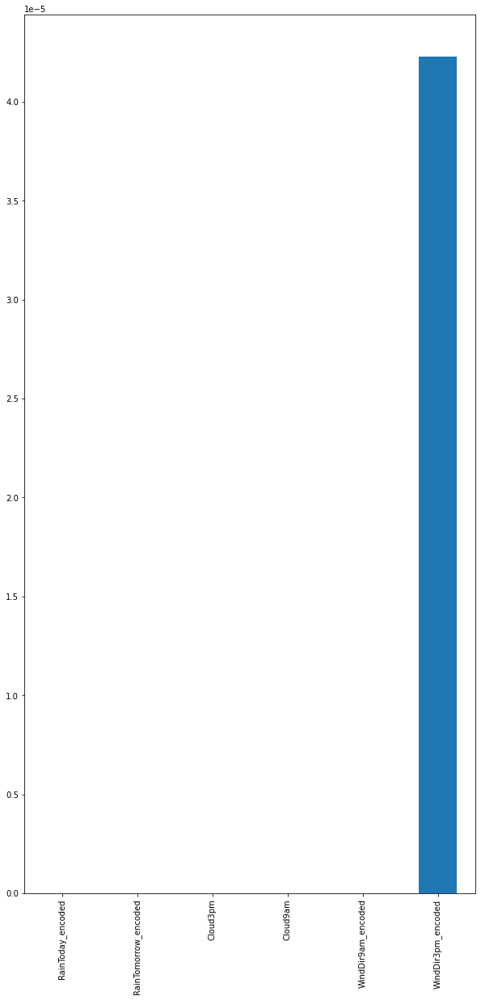

In [136]:
sel=f_classif(Xf_train, Y_train)
p_values=pd.Series(sel[1])
p_values.index=Xf_train.columns
p_values.sort_values(ascending=True, inplace=True)
p_values.plot.bar(figsize=(10,20))

# I have used these transformed values to generate pvalue of each feature (to explain label).

# Mathematical Notation

P Value = (sample proportion - Assumed population proportion in the null hypothesis)/(sqrt((Assumed population proportion in the null hypothesis * ( 1 - Assumed population proportion in the null hypothesis )) / n))

In [137]:
p_values=p_values[p_values<0.05]
p_values.index

Index(['RainToday_encoded', 'RainTomorrow_encoded', 'Cloud3pm', 'Cloud9am',
       'WindDir9am_encoded', 'WindDir3pm_encoded'],
      dtype='object')

# P Values are an important component of feature selection, with significance level set to 0.1, Variance Threshold
    ensemble technique returns with 90% confidence, all the features that have maximum explanatory capacity
For the present dataset features with pvalues with less than 0.1 are:
Index(['RainToday_encoded', 'RainTomorrow_encoded', 'Cloud9am', 'Cloud3pm',
       'WindDir9am_encoded', 'WindDir3pm_encoded'],
      dtype='object')

In [138]:
import numpy as np
x=x_frame1.copy()
x=x[['RainToday_encoded', 'RainTomorrow_encoded', 'Cloud9am', 'Cloud3pm',
       'WindDir9am_encoded', 'WindDir3pm_encoded']]
x.sample()

,RainToday_encoded,RainTomorrow_encoded,Cloud9am,Cloud3pm,WindDir9am_encoded,WindDir3pm_encoded
2315,0.0,1.0,0.782198,0.178531,0.566084,0.550024


# The above table displays a sample of final x vector with features and values finally selected to be used for prediction.

In [139]:
y.sample()

8232    0.0
Name: Rainfall, dtype: float64

# The above series displays a sample of label.

In [140]:
x.shape, y.shape

((8425, 6), (8425,))

# The above cell displays final shapes of x and y vectors

In [141]:
x_train, x_test, y_train, y_test=train_test_split(x,y,test_size=0.3)

In [142]:
x_train.shape, y_train.shape

((5897, 6), (5897,))

# In the above two cells, I have divided final vectors with train test split technique, in which train data is 70% and test data is 30% to avoid overfitting issue.

# Model Development, Evaluation And Saving (Models =5)


# Selection Reasoning Of Models 1 to 5


# The goal of ensemble methods is to combine the predictions of several base estimators built with a given learning algorithm in order to improve generalizability / robustness over a single estimator.

Two families of ensemble methods are usually distinguished:

In averaging methods, the driving principle is to build several estimators independently and then to average their predictions. On average, the combined estimator is usually better than any of the single base estimator because its variance is reduced.

Examples: Bagging methods, Forests of randomized trees, etcetera

By contrast, in boosting methods, base estimators are built sequentially and one tries to reduce the bias of the combined estimator. The motivation is to combine several weak models to produce a powerful ensemble.

Examples: AdaBoost, Gradient Tree Boosting,etcetera

# The use case assigned revolves around uneven data points hence there is high probality of not achieving a good fit. Hence, I have tried different ensembele techniques that can lower variance and bias and help achieve a goodness of fit. (Just as a reminder, I have already applied variance threshold of 0.01 to ensure that risk of models is low).

# The theories in the two cells above explain why I have chosen Model 1, Model 2, Model 3, Model 4 and Model 5 for this use case. Model 5 is decision tree regressor and hence, is again a very powerful implementation to prevent illness of fit.

# Model 1

# Extra Tree Regressor With Default HyperParameter Tuning


In [143]:
from sklearn.ensemble import RandomForestRegressor as el
from sklearn.model_selection import cross_val_score
from sklearn.datasets import load_boston
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesRegressor
import pickle
best_estim=ExtraTreesRegressor()
best_estim.fit(x_train,y_train)
y_pred2=best_estim.predict(x_train)
mse2 = mean_squared_error(y_train, y_pred2)
model3_train_score=best_estim.score(x_train, y_train)
model3_test_score=best_estim.score(x_test, y_test)
rmse2=np.sqrt(mse2)
ytst_pred2=best_estim.predict(x_test)
mse_test2=mean_squared_error(y_test, ytst_pred2)
rmse_test2=np.sqrt(mse_test2)
model3_prediction_train=pd.DataFrame({'y_train':y_train, 'yhat':y_pred2})
model3_prediction_test=pd.DataFrame({'y_test':y_test, 'yhat':ytst_pred2})

In [145]:
print('Train Score: ',np.round(model3_train_score,2))
print('Test Score: ',np.round(model3_test_score,2))
print('MSE Train: ',np.round(mse2,2))
print('RMSE Train: ',np.round(rmse2,2))
print('MSE Test: ',np.round(mse_test2,2))
print('RMSE Test: ',np.round(rmse_test2,2))

Train Score:  0.9
Test Score:  0.31
MSE Train:  14.3
RMSE Train:  3.78
MSE Test:  93.02
RMSE Test:  9.64


# Model 2

# Random Forest Regressor With Default Hyper Parameter Tuning

In [146]:
from sklearn.ensemble import RandomForestRegressor as el
from sklearn.model_selection import cross_val_score
rfc=el()
rfc.fit(x_train, y_train)
print(rfc.score(x_train, y_train))
print(rfc.score(x_test, y_test))
scores=cross_val_score(rfc, x, y, cv=5)
cv_scores=scores.mean()
print(scores.std())
print(cv_scores)

0.821037220940501
0.3883234429365835
0.5852416098077875
-0.09219786345114744


In [147]:
train_prediction=rfc.predict(x_train)
test_prediction=rfc.predict(x_test)

In [148]:
mse_train = mean_squared_error(y_train, train_prediction)
mse = mean_squared_error(y_test, test_prediction)
rmse_train = np.sqrt(mse_train)
rmse = np.sqrt(mse)
mse_train, mse, rmse_train, rmse

(25.69423926251765, 82.09729155872115, 5.068948536187525, 9.060755573279812)

In [149]:
best_model=pickle.dumps(rfc) # saving the best model

# Model 3

# Ada Boost Regressor And Random Forest Regressor With Grid Search CV Hyper Parameter Tuning and Ada Boost Boosting

In [150]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error, make_scorer, r2_score
import matplotlib.pyplot as plt
abreg = AdaBoostRegressor()
params = {
 'n_estimators': [50, 100],
 'learning_rate' : [0.01, 0.05, 0.1, 0.5],
 'loss' : ['linear', 'square', 'exponential']
 }
score = make_scorer(mean_squared_error)
print(score)

make_scorer(mean_squared_error)


In [151]:
gridsearch=GridSearchCV(abreg, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)
GridSearchCV(cv=5, error_score='raise', estimator=AdaBoostRegressor(base_estimator=rfc, learning_rate=1.0,loss='linear', n_estimators=50, random_state=None), n_jobs=1, param_grid={'n_estimators': [50, 100],'learning_rate': [0.01, 0.05, 0.1, 0.5],'loss': ['linear', 'square', 'exponential']},pre_dispatch='2*n_jobs', refit=True, return_train_score=True,scoring=None, verbose=0) 

GridSearchCV(cv=5, error_score='raise',
             estimator=AdaBoostRegressor(base_estimator=RandomForestRegressor()),
             n_jobs=1,
             param_grid={'learning_rate': [0.01, 0.05, 0.1, 0.5],
                         'loss': ['linear', 'square', 'exponential'],
                         'n_estimators': [50, 100]},
             return_train_score=True)

In [152]:
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'learning_rate': 0.01, 'loss': 'exponential', 'n_estimators': 50}
0.27101244560963417


In [153]:
best_estim=gridsearch.best_estimator_
print(best_estim)

AdaBoostRegressor(learning_rate=0.01, loss='exponential')


In [154]:
best_estim.fit(x_train,y_train)

ytr_pred=best_estim.predict(x_train)
mse = mean_squared_error(y_train, ytr_pred)
print('Train Score: ', best_estim.score(x_train, y_train))
print('Test score: ', best_estim.score(x_test, y_test))

Train Score:  0.260797920270497
Test score:  0.2761101866162484


In [155]:
ytst_pred=best_estim.predict(x_test)
print('mse_train', mse)
print('rmse_train', np.sqrt(mse))
mse_test = mean_squared_error(y_test, ytst_pred)
print('mse_test', mse_test)
print('rmse_test', np.sqrt(mse_test))

mse_train 106.12952704319541
rmse_train 10.301918609812223
mse_test 97.15819967184498
rmse_test 9.856885901330347


# Model 4

# Extra Trees Regressor With Grid Search CV Hyper Parameter Tuning

In [156]:
import sklearn
abreg = sklearn.ensemble.ExtraTreesRegressor()
params = {
 'n_estimators': [50, 100],
 'max_samples' : [0.01, 0.05, 0.1],
 'bootstrap' : [True],
 'oob_score' : [True],
 'warm_start' : [True],
 'n_jobs'  : [1,-1],
 'random_state' : [0,10,100,1000],
 'criterion' : ['mse','mae'] 
 }
score = make_scorer(mean_squared_error)
print(score)

make_scorer(mean_squared_error)


In [157]:
gridsearch=GridSearchCV(abreg, params, cv=5, return_train_score=True)
gridsearch.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=ExtraTreesRegressor(),
             param_grid={'bootstrap': [True], 'criterion': ['mse', 'mae'],
                         'max_samples': [0.01, 0.05, 0.1],
                         'n_estimators': [50, 100], 'n_jobs': [1, -1],
                         'oob_score': [True],
                         'random_state': [0, 10, 100, 1000],
                         'warm_start': [True]},
             return_train_score=True)

In [158]:
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'bootstrap': True, 'criterion': 'mae', 'max_samples': 0.1, 'n_estimators': 100, 'n_jobs': 1, 'oob_score': True, 'random_state': 100, 'warm_start': True}
0.30129223795107046


In [159]:
best_estim=gridsearch.best_estimator_
print(best_estim)

ExtraTreesRegressor(bootstrap=True, criterion='mae', max_samples=0.1, n_jobs=1,
                    oob_score=True, random_state=100, warm_start=True)


In [161]:
best_estim.fit(x_train,y_train)

ytr_pred=best_estim.predict(x_train)
yts_pred=best_estim.predict(x_test)
mse = mean_squared_error(y_train, ytr_pred)
print('Train Score: ', best_estim.score(x_train, y_train))
print('Test score: ', best_estim.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(y_test, yts_pred)
print('mse_test: ', mse_test)
print('rmse_test', np.sqrt(mse_test))

Train Score:  0.38311935487565474
Test score:  0.3109257808748258
mse_train:  88.56746065041546
rmse_train 9.411028671214186
mse_test:  92.48536080033624
rmse_test 9.616930944970763


# Model5

# Decision Tree Regressor With Default Hyper Parameter Tuning

In [162]:
from sklearn.tree import DecisionTreeRegressor
tree=DecisionTreeRegressor()
tree.fit(x_train, y_train)

DecisionTreeRegressor()

In [163]:
tree.score(x_test, y_test)

0.33524340393162766

In [164]:
ytr_pred=tree.predict(x_train)
yts_pred=tree.predict(x_test)
mse = mean_squared_error(y_train, ytr_pred)
print('Train Score: ', tree.score(x_train, y_train))
print('Test score: ', tree.score(x_test, y_test))
print('mse_train: ', mse)
print('rmse_train', np.sqrt(mse))
mse_test=mean_squared_error(y_test, yts_pred)
print('mse_test: ', mse_test)
print('rmse_test', np.sqrt(mse_test))

Train Score:  0.9004253242246343
Test score:  0.33524340393162766
mse_train:  14.296243930193185
rmse_train 3.781037414545535
mse_test:  89.22152639789671
rmse_test 9.445714710803873


# Best Model is saved in pickle for production

# Conclusion
# There is 1 Best Models based on mse and rmse scores and best fit:

# Model2: Random Forest Regressor With Default Hyper Parameter Tuning

## MSE Train: 25.69423926251765,

## MSE Test: 82.09729155872115, 

## RMSE Train: 5.068948536187525, 

## RMSE Test: 9.060755573279812)

# Credits:
DataTrained and Python Documentations.